
## Введение
Больше контекста про продукт - https://github.com/Hyper-glitch/artifex-ai

Данную задачу можно решить несколькими способами, но мы начнем с простого варианта и будем усложнять по мере необходимости.

Для начала будем использовать RAG подход для улучшения промпта юзера, основываясь на фирменом бренд-буке компании и дальнейшей генерации с помощью `Stable Diffusers`.
В дальнейшем, если потребуется, будем дообучать `LoRA adapter` на описаниях изображений брендбука.


## 1. Загрузка и очистка данных
Необходимо преобразовать бренд-бук из PDF в текст.
Извлеченный текст будем использовать для создания `FAISS` индекса и использования его в `RAG` пайплайне.

In [31]:
!pip install PyMuPDF
!pip install nltk

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 85.6 MB/s eta 0:00:00:00:0100:01


#### 1.1 Извлечение данных из PDF

In [32]:
import fitz
from pathlib import Path


def extract_text_from_pdf(pdf_path: Path) -> str:
    document = fitz.open(pdf_path)
    text = ""

    for page_num in range(len(document)):
        page = document.load_page(page_num)        
        parsed_text = page.get_text()
        print(f"parsed_text: {parsed_text}")

        text += parsed_text

    return text

In [33]:
# Запуск и проверка что текст пустой

pdf_path = Path("/kaggle/input/guideline/guidelines.pdf")
text = extract_text_from_pdf(pdf_path)

parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed_text: 
parsed

### Комментарий (!)
В ходе использования библиотеки `fitz` для парсинга `pdf-to-text` выяснилось, что `pdf` содержит сканы изображений и он не способен распарсить его в текст, `page.get_text()` возвращает пустой текст.

В связи с этим принято решение использовать базовый `OCR` в виде библиотеки `pytesseract`. 

In [34]:
!pip install pytesseract

In [35]:
"""Функция для извлечение данных из PDF с помощью OCR."""

from PIL import Image
import pytesseract


def extract_text_with_ocr(page):
    pix = page.get_pixmap()
    img = Image.frombytes("RGB", [pix.width, pix.height], pix.samples)
    return pytesseract.image_to_string(img)

In [36]:
"""Извлечение данных из PDF с помощью OCR"""

import fitz
from pathlib import Path


def pdf_to_text_with_ocr(pdf_path: Path) -> str:
    document = fitz.open(pdf_path)
    text = ""

    for page_num in range(len(document)):
        page = document.load_page(page_num)        
        parsed_text = extract_text_with_ocr(page)

        text += parsed_text

    print("All pages processed successfully.")
    return text

In [6]:
# Запуск и проверка с OCR

pdf_path = Path("/kaggle/input/guideline/guidelines.pdf")
text = pdf_to_text_with_ocr(pdf_path)

All pages processed successfully.


#### Распознанный текст с помощью `pytesseract` (eng)

In [7]:
text

'Sieh Za val mene aT Ve ae\n\n \n\x0clNnamdopma\n\nTv\n\x0cice}\n\nNouemy ecom.tech\n\nOOveguHeHUe KOMnNaHUU CamoHam,\nMeraMapHem, COepslorucmukKa, COepMapkem\nOMHpbInNo HOBbIU Macwma6 BO3SMOHHOCMe\npasBumuA, a BMecme Cc 9muUM\nHeoOxogumMocmb UugseHmuduuUpoBamb ceba\nHa IT-pbIHHe HaHK OnA BHympeHHeU\naygumopuu compy@HuKOB, mak u gana\nBHEWHUX COUCKamenelt.\n\nHospi 6peHm ecom.tech — 9mo\nBU3syanUu3sauuUA Hawero rnobanbHoro\nBugeHuA, SOonbwWUX Uenet, OObenUHAIOWAA\ncuna u 3amMemHbiIG CUurHan BOBHe.\n\x0cice}\n\nna Koro Mbl fenaem ecom.tech\n\nAna BHewHeU aygumopuu ecom.tech -\n9mo B nepByi OY4epegb npuBNekKamenbHbIU\nU cCOBpemMeHHBIU GpeHA padomogamena.\n\nAna BHympeHHet ayfumopuu compygGHuUKOB\n- oOveguHAWWuUt O6pas gna\nCamougeHmudukauuu U eguUHcmBa.\n\x0cice}\n\nXapakmep 6peHga\n\nJlugep u sHmy3uacm, cmenbiu,\nycmotuuspll, Ovicmppi, monepaHmHpit\nK U3MCHEHUAM, OCO3HAHHO\nHepaBHoAyuHbIG, OmBemcmBeHHbIU.\n\nEro MHR - 9mo uHteHepHaA KyNbmypa\nU CBASaHHBIU C 9MUM POMaHMU3M, AYX\nomkpbimu

### Комментарий (!)
Из полученного текста видно, что он не представляет для нас никакой ценности, так как `pytesseract` по умолчанию работает с английским языком. Установим плагин `tesseract-ocr-rus` для русского языка.

In [37]:
!apt install tesseract-ocr-rus

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following NEW packages will be installed:
  tesseract-ocr-rus
0 upgraded, 1 newly installed, 0 to remove and 122 not upgraded.
Need to get 1,271 kB of archives.
After this operation, 3,877 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-rus all 1:4.00~git30-7274cfa-1.1 [1,271 kB]
Fetched 1,271 kB in 2s (746 kB/s)            

78Selecting previously unselected package tesseract-ocr-rus.
(Reading database ... 128691 files and directories currently installed.)
Preparing to unpack .../tesseract-ocr-rus_1%3a4.00~git30-7274cfa-1.1_all.deb ...
7Progress: [  0%] [..........................................................] 87Progress: [ 20%] [###########...............................................] 8Unpacking tesseract-ocr-rus (1:4.00~git30-7274cfa-1.1) ...
7Progress: [ 40%] [#######################....................

In [38]:
"""Функция для извлечение данных из PDF с помощью OCR, ru+eng языки."""

from PIL import Image
import pytesseract


def extract_text_with_ocr(page):
    pix = page.get_pixmap()
    img = Image.frombytes("RGB", [pix.width, pix.height], pix.samples)
    return pytesseract.image_to_string(img, lang='rus+eng')

In [39]:
# Запуск и проверка с OCR, ru+eng языки

pdf_path = Path("/kaggle/input/guideline/guidelines.pdf")
text = pdf_to_text_with_ocr(pdf_path)

All pages processed successfully.


#### Распознанный текст с помощью `pytesseract` (ru+eng)

In [40]:
text

'Визуальный стиль Ve ae\n\n \n\x0cПлатформа\n\nДе\n\x0c(0)\n\nNouemy ecom.tech\n\nОбъединение номпаний CamoHam,\nМегаМарнет, СберЛогистина, СберМарнет\nотнрыло новый масштаб возможностей\nразвития, а вместе с этим\nнеобходимость идентифицировать себя\nна ТТ-рынне нан для внутренней\nаудитории сотруднинов, тан и для\nвнешних соуснателей.\n\nНовый бренд есот.+есН — это\nвизуализация нашего глобального\nвидения, больших целей, объединяющая\nсила и заметный сигнал вовне.\n\x0c(0)\n\nna Koro Mbl fenaem ecom.tech\n\nAna BHewHeU aygumopuu ecom.tech -\nэто в первую очередь привленательный\nи современный бренд работодателя.\n\nДля внутренней аудитории сотруднинов\n— объединяющий образ для\nсамоидентифинации и единспва.\n\x0c(0)\n\nХарантер бренда\n\nJlugep u sHmy3uacm, cmenbiu,\nустойчивый, быстрый, толерантный\nнк чзменениям, осознанно\nнеравнодушный, ответственный.\n\nЕго ДНН - это инженерная нультура\nи связанный с этим романтизм, дух\nomkpbimut u cBepweHulu.\n\x0c(0)\n\nUWeHHocmu\n\nНаши це

#### Комментарий (!)
Да, качество распознавания не идеальное, И на данном этапе мы не уделяем много времени данному этапу.

Улучшение распознавание планируется на следующую итерацию - улучшения пайплайна моделей - поэтому оставляем здесь как есть.

Другого `.pdf` файла с явным текстовым слоем у нас нет.

In [23]:
"""Module for text preprocessing and segmentation"""

import re
from nltk.tokenize import sent_tokenize


def clean_text(text: str) -> str:
    """Removing extra spaces, invisible characters and duplicate lines."""
    text = text.replace("\xa0", " ").replace("\t", " ")
    text = re.sub(r'\n{2,}', '\n', text)
    text = re.sub(r'[ ]{2,}', ' ', text) 
    
    return text.strip()


def split_into_chunks(text: str, max_sentences: int = 5) -> list[str]:
    """Breaks text into chunks of N sentences for more meaningful passages."""
    sentences = sent_tokenize(text)
    chunks = []

    for i in range(0, len(sentences), max_sentences):
        chunk = " ".join(sentences[i:i + max_sentences])
        if len(chunk) > 30:
            chunks.append(chunk.strip())

    return chunks


def process_brandbook_text(full_text: str) -> list[dict[str, str]]:
    clean = clean_text(full_text)
    chunks = split_into_chunks(clean)
    return [{"content": chunk} for chunk in chunks]


#### 1.2 Векторизация текста

In [24]:
!pip install sentence-transformers

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.7 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.5 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.3 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 29.4 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.2 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 2.3 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 83.8 MB/s eta 0:00:00:00:0100:01
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.8.93
    Uninstalling nvidia-nvjitlink-cu12-12.8.93:
      Successfully uninstalled nvidia-nvjitlink-cu12-12.8.93
  Attempting uninstall: nvidia-curand-cu12
    Found existing installation: nvidia-curand-cu12 10.3.9.90
    Uninstalling nvidia-curand-cu12-1

In [25]:
from sentence_transformers import SentenceTransformer
import numpy as np


def vectorize_chunks(embed_model: SentenceTransformer, chunks: list[dict]) -> list[dict]:
    """
    Принимает список чанков вида [{"content": str}], возвращает список с эмбеддингами
    """
    texts = [chunk["content"] for chunk in chunks]
    embeddings = embed_model.encode(texts, convert_to_numpy=True, show_progress_bar=True)

    for chunk, emb in zip(chunks, embeddings):
        chunk["embedding"] = emb

    return chunks

In [6]:
# Установка FAISS индекса
!pip install faiss-cpu

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 31.3/31.3 MB 46.1 MB/s eta 0:00:00:00:0100:01


In [20]:
"""Create FAISS index."""

import faiss
import numpy as np
import torch


def build_faiss_index(embeddings: list[np.ndarray]) -> faiss.Index:
    dim = embeddings[0].shape[0]
    index_flat = faiss.IndexFlatL2(dim)

    faiss_vectors = np.stack(embeddings).astype(np.float32)
    index_flat.add(faiss_vectors)

    return index_flat

In [12]:
def search_similar(guideline_content: list[str], user_prompt: str, embed_model: SentenceTransformer, faiss_index: faiss.Index, top_k=3) -> list[str]:
    embedding = embed_model.encode([user_prompt]).astype("float32")
    distances, indices = faiss_index.search(embedding, top_k)
    relevant_guidelines = [guideline_content[i] for i in indices[0]]

    return relevant_guidelines

In [26]:
"""Загрузка модели на девайс."""
from sentence_transformers import SentenceTransformer


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device.type)

embed_model = SentenceTransformer("paraphrase-multilingual-MiniLM-L12-v2", device=device)

cuda


modules.json:   0%|          | 0.00/229 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/122 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/3.89k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/645 [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


model.safetensors:   0%|          | 0.00/471M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/480 [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


tokenizer.json:   0%|          | 0.00/9.08M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/239 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

In [41]:
"""Получение эмбеддингов."""

chunks = process_brandbook_text(text)
vectorized_chunks = vectorize_chunks(embed_model, chunks)
embeddings = [chunk["embedding"] for chunk in vectorized_chunks]

Batches:   0%|          | 0/2 [00:00<?, ?it/s]

In [42]:
"""Сохранение чанков описания гайдлайна для RAG"""
import json


guideline_content = [chunk["content"] for chunk in vectorized_chunks]

with open("guideline_content.json", "w", encoding="utf-8") as file:
    json.dump(guideline_content, file, ensure_ascii=False, indent=2)


In [45]:
"""Создание и сохранение FAISS индекса."""

faiss_index = build_faiss_index(embeddings)
faiss.write_index(faiss_index, "guideline.index")

In [43]:
user_prompt = "I want an abstract person with abstractions in light colors"

In [46]:
relevant_guidelines = search_similar(guideline_content=guideline_content, user_prompt=user_prompt, embed_model=embed_model, faiss_index=faiss_index)
print(relevant_guidelines)

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

['Не применять дополнительные эффенты н начертанию Влоснз. 4. Не разделять один смысловой блон тенста на неснольно\nцветовых сочетаний. я\nРУНОВОДИТЕЛЬ =\n ТЛЕЛА ТОВАРОВ\nИ\nOTAENA\n \n\x0c1. Гарнитура $49па1 Мопо в начестве заголовочного шрифта.', '3anpewaemca ucnonbsosamb 2D BMecme\nс 35, а танже фотографии. оС\nKAPbEPHDIE\nЯЗЬ\nВЕ-СОМ\n \n\x0c[9] Принципы манетирования / бгарНБ1сз Расн\nMono/Graph/Bold\nСпец. эффент\nFLOW\n2024\nMEETOP\n10\nVoll\nАА\nА-а]\nМанс. 3 цвета ®omo\n2D 3D\nПри работе с имитацией нонгрева для иллюстраций правила остаются\nпаними же, нан и при работе с обычными 20 иллюстрациями. Запрещается\nиспользовать 20 вместе с 30, а танже фотографии и начертание ВЛосн$.', 'Более\nпого, 30 должна отличаться по цвету от остальных 2 цветов на макете. Mono/Graph/Bold 3D\nМанс. 2 цвета [Хх] 20 [Х] Фото\n\x0c[9] Принципы манетирования / бгарНБ1сз Расн\nРАЗВИТИЕ\nЕСФМ-А В МИРЕ\nНан начать свой путь в 0$ 24/08/25\n \n(V] Mono/Graph/Bold [У] Манс. А цвета\nГВ: 5 (V] 2D\n \nФото

### Вывод
Таким образом нам удалось перевести `pdf` файл на русском и английском языках в векторы и создать по ним `FAISS` индекс для использования в нашем `RAG` пайплайне.

## 2. Анализ данных
В `.pdf` гайдлайне также присутствуют изображения (шаблоны абстракций, цветовые сочетания и тд). Для того чтобы перевести их в машиночитаемый вид воспользуемся `image-to-text` моделями. Датасет изображений был сформирован вручную, так как в `.pdf` файле на изображениях (абстракции, цветовые сочетания) было сразу размещено до 30 разных небольших изображений и средствами автоматизации такое не сделать.

Полученные описания можно векторизовать и обогощать `system_prompt` - таким образом описание для генерации станет подробнее, что повлияет на качество конечного изображения.

Также данные описания могут пригодится нам в дальнейшем для дообучения `LoRA adapter` для `Stable Diffusers`. 

#### `Salesforce/blip2-opt-2.7b` (https://huggingface.co/Salesforce/blip2-opt-2.7b)

Одна из самых простых и легковесных моделей для описания изображений, не работает с промптом.

In [1]:
import torch
import pandas as pd
from PIL import Image
from tqdm import tqdm
from pathlib import Path
from transformers import Blip2Processor, Blip2ForConditionalGeneration


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device.type)

2025-05-14 18:43:24.734213: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1747248204.940897      31 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1747248204.999129      31 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


cuda


In [24]:
simple_processor = Blip2Processor.from_pretrained("Salesforce/blip2-opt-2.7b")
simple_model = Blip2ForConditionalGeneration.from_pretrained(
    "Salesforce/blip2-opt-2.7b",
    torch_dtype=torch.float16,
    device_map=device,
)

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


preprocessor_config.json:   0%|          | 0.00/432 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/882 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/798k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/3.56M [00:00<?, ?B/s]

added_tokens.json:   0%|          | 0.00/23.0 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/548 [00:00<?, ?B/s]

processor_config.json:   0%|          | 0.00/68.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.03k [00:00<?, ?B/s]

model.safetensors.index.json:   0%|          | 0.00/122k [00:00<?, ?B/s]

Fetching 2 files:   0%|          | 0/2 [00:00<?, ?it/s]

model-00002-of-00002.safetensors:   0%|          | 0.00/4.98G [00:00<?, ?B/s]

model-00001-of-00002.safetensors:   0%|          | 0.00/10.0G [00:00<?, ?B/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/141 [00:00<?, ?B/s]

In [10]:
def read_prompt(prompt_path: Path) -> str:
    with open(prompt_path, "r", encoding="utf-8") as f:
        return f.read().strip()
        

def get_img_captions(dataset_path: Path, processor, model, device: torch.device, prompt: str = "") -> pd.DataFrame:
    img_captions = []

    for folder in tqdm(sorted(dataset_path.iterdir()), desc="Processing folders"):
        if not folder.is_dir():
            continue

        for image_path in folder.iterdir():
            if image_path.suffix.lower() not in (".png", ".jpg", ".jpeg", ".webp"):
                continue

            try:
                image = Image.open(image_path).convert("RGB")
                inputs = processor(images=image, text=prompt, return_tensors="pt").to(device)

                with torch.no_grad():
                    generated_ids = model.generate(**inputs)

                caption = processor.batch_decode(generated_ids, skip_special_tokens=True)[0]
                
                img_captions.append({
                    "folder": folder.name,
                    "image_name": image_path.name,
                    "prompt": prompt,
                    "caption": caption,
                })
            except Exception as e:
                print(f"[X] Ошибка с {image_path}: {e}")

    return img_captions

In [3]:
def save_captions(img_captions: list[dict], model) -> None:
    df = pd.DataFrame(img_captions)
    df.to_csv(f"{model.__class__.__name__.lower()}_img_captions.csv", index=False, encoding="utf-8")
    print(f"✅ Сохранено {len(df)} описаний в img_captions.csv")

In [4]:
DATASET = Path("/kaggle/input/images/imgs")

In [ ]:
img_captions = get_img_captions(dataset_path=DATASET, model=simple_model, processor=simple_processor, device=device)
save_captions(img_captions, simple_model)

#### Результаты сбора описаний изображений с моделью `Salesforce/blip2-opt-2.7b`

In [5]:
import matplotlib.pyplot as plt


def show_caption(item: dict[str, str]) -> None:
    image_path = Path(DATASET) / item['folder'] / item['image_name']
    caption = item['caption'].strip()
    image = Image.open(image_path)

    plt.figure(figsize=(5, 5))
    plt.imshow(image)
    plt.axis('off')
    plt.title(caption, fontsize=10)
    plt.show()

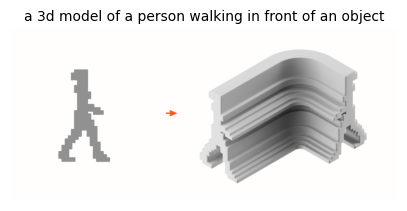

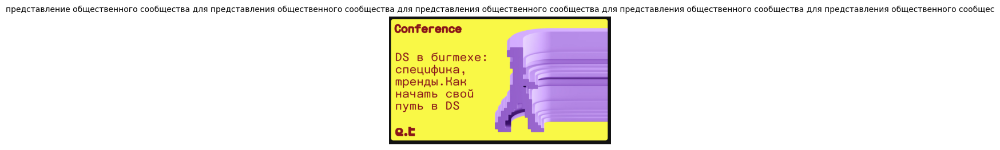

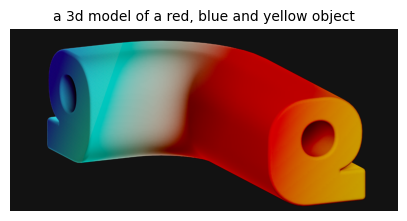

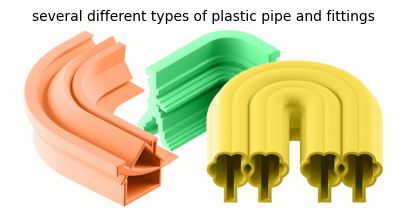

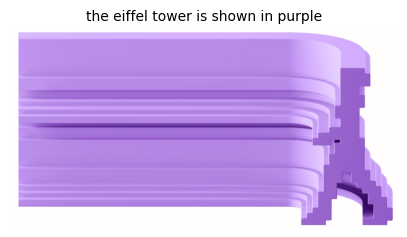

...

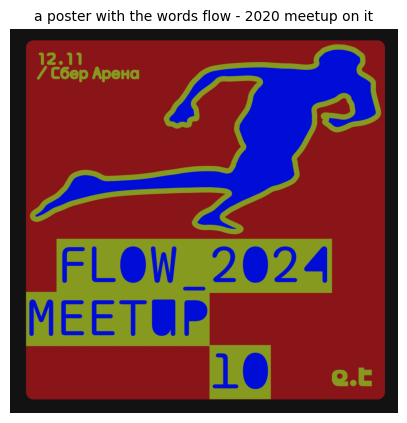

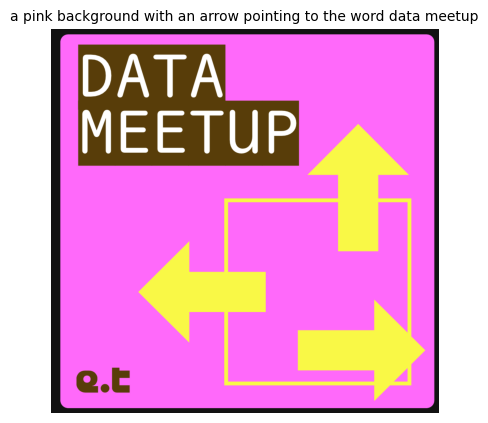

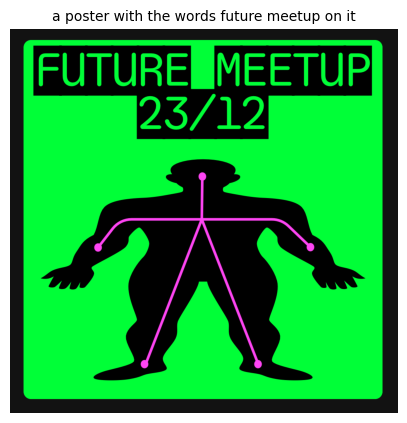

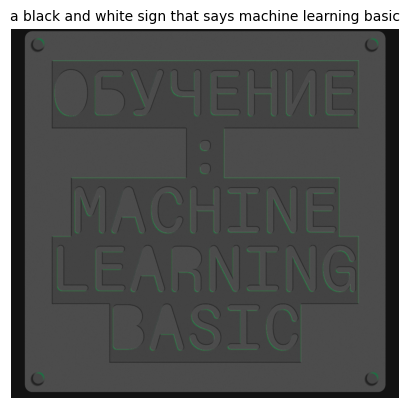

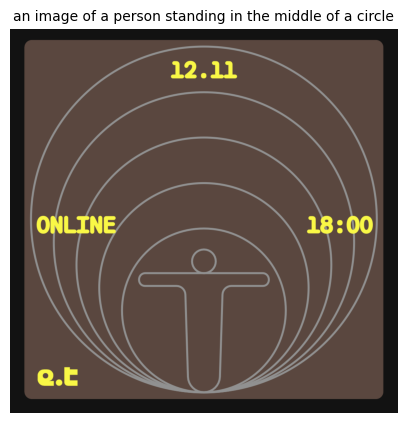

In [37]:
for item in img_captions:
    show_caption(item)

#### Вывод

В целом "визуально" результаты приемлимы, и на этапе `baseline` и техническими ограничениями по `GPU` мы не будем выбирать и сравнивать разные модели для получения `captions` с применением метрик, остановимся на этой.

В дальнейшем, как одной из точек роста качества всего пайплайна можно рассмотреть более продвинутые модели.
Например: `LLaVA-1.5` (https://huggingface.co/llava-hf/llava-1.5-13b-hf)

#### Создадим FAISS индекс для полученных описаний с изображений.

In [10]:
embed_model = SentenceTransformer("paraphrase-multilingual-MiniLM-L12-v2", device=device)

modules.json:   0%|          | 0.00/229 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/122 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/3.89k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/645 [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


model.safetensors:   0%|          | 0.00/471M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/480 [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


tokenizer.json:   0%|          | 0.00/9.08M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/239 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

In [9]:
import pandas as pd
import faiss
import numpy as np
from sentence_transformers import SentenceTransformer
import pickle


model_name = model.__class__.__name__.lower()
df = pd.read_csv(f"{model_name}_img_captions.csv")
embeddings = embed_model.encode(df["caption"].tolist(), show_progress_bar=True)

faiss_index = build_faiss_index(embeddings)
faiss.write_index(faiss_index, f"{model_name}_img_captions.index")
print(f"✅ Готово! В индекс добавлено {len(embeddings)} описаний.")


2025-05-18 17:56:23.894568: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1747590984.164453      31 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1747590984.242794      31 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


NameError: name 'model' is not defined

#### Найдем ближайшие `top_k` описаний изображений под пользовательский запрос

In [19]:
query = "abstract man which walking"
top_k = 3

embedding = embed_model.encode([query]).astype("float32")
distances, indices = faiss_index.search(embedding, top_k)

for idx in indices[0]:
    row = df.iloc[idx]
    print(f"[{idx}] {row['caption']}")

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

[42] The image depicts a silhouette of a man walking with an umbrella on his head, which could be used as a prompt for fine-tuning a Stable Diffusion LoRA adapter, focusing on geometry, composition, and stylistic elements. The silhouette of a man walking with an umbrella on his head could be used as a prompt for fine-tuning a Stable Diffusion LoRA adapter, focusing on geometry, composition, and stylistic elements.
[28] The image depicts a silhouette of a man standing in front of a gray background, which is a minimalistic style and abstract category that can be used as a prompt for fine-tuning a Stable Diffusion LoRA adapter, focusing on geometry, composition, and stylistic elements.
[16] The image depicts a silhouette of a man standing in front of a circle of circles, which is a minimalistic style and abstract category that can be used as a prompt for fine-tuning a Stable Diffusion LoRA adapter, focusing on geometry, composition, and stylistic elements.


## 3. Выбор 1-2 простых модели и 1 усложнённой

В качестве простых моделей возьмем `Stable Diffusion 1.5` и `Stable Diffusion 2.1-base`. В качестве усложненной - `Kandinsky 2.2`

In [ ]:
pip install diffusers transformers accelerate xformers

In [ ]:
pip install transformers diffusers

In [3]:
import torch


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device.type)

cuda


In [7]:
# Загружаем индексы и описания с бренд-бука

import faiss
import json
import pandas as pd


blip_pro_index = faiss.read_index("/kaggle/input/blip-pro/instructblipforconditionalgeneration_img_captions.index")
blip_pro_df = pd.read_csv("/kaggle/input/blip-pro/InstructBlipForConditionalGeneration_img_captions.csv")

guideline_index = faiss.read_index("/kaggle/input/guideline-index/guideline.index")
with open("/kaggle/input/guideline-index/guideline_content.json", "r", encoding="utf-8") as file:
    guideline_content = json.load(file)

#### Подготавливаем промпт для `Stable Diffusion`

In [8]:
user_prompt = "I want an abstract person with abstractions in light colors"

In [13]:
relevant_guidelines = search_similar(guideline_content=guideline_content, user_prompt=user_prompt, embed_model=embed_model, faiss_index=guideline_index)

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

In [14]:
image_captions = search_similar(guideline_content=blip_pro_df["caption"], user_prompt=user_prompt, embed_model=embed_model, faiss_index=blip_pro_index)

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

In [15]:
guidelines_str = "\n".join(f"- {g}" for g in relevant_guidelines)
captions_str = "\n".join(f'{i+1}. "{desc}"' for i, desc in enumerate(image_captions))

system_prompt = f"""
You are a creative assistant that transforms user image requests into refined, brand-consistent prompts for Stable Diffusion. Your goal is to generate a final visual prompt that strictly follows brand guidelines and emphasizes clarity, structure, and stylistic consistency.

Your task:
1. Read the user input describing the desired visual.
2. Use the brand guidelines to ensure the prompt follows the company’s visual identity.
3. Use the example image descriptions as inspiration for tone, structure, and stylistic direction.
4. Output a final, standalone prompt that can be used directly with Stable Diffusion.

Requirements:
- The prompt must be written in clear, professional English.
- It should describe a minimalistic, abstract, and brand-consistent image.
- Do not include any instructions, explanations, or brand guideline text in the final output.
- Avoid photographic elements, 3D features, or effects prohibited by the brand.
- Limit the number of colors if required, and use flat design principles.

Inputs:

User input:
"{user_prompt}"

Relevant brand guidelines:
{guidelines_str}

Example image descriptions:
{captions_str}

Output:
Return only the final refined prompt suitable for Stable Diffusion.
"""

In [16]:
system_prompt

'\nYou are a creative assistant that transforms user image requests into refined, brand-consistent prompts for Stable Diffusion. Your goal is to generate a final visual prompt that strictly follows brand guidelines and emphasizes clarity, structure, and stylistic consistency.\n\nYour task:\n1. Read the user input describing the desired visual.\n2. Use the brand guidelines to ensure the prompt follows the company’s visual identity.\n3. Use the example image descriptions as inspiration for tone, structure, and stylistic direction.\n4. Output a final, standalone prompt that can be used directly with Stable Diffusion.\n\nRequirements:\n- The prompt must be written in clear, professional English.\n- It should describe a minimalistic, abstract, and brand-consistent image.\n- Do not include any instructions, explanations, or brand guideline text in the final output.\n- Avoid photographic elements, 3D features, or effects prohibited by the brand.\n- Limit the number of colors if required, and 

### Пояснение (!)
Далее нам необходимо улучшить промпт с помощью `LLM`. Но так как технической возможности развернуть `LLM` в `kaggle` нет, то на этапе `baseline`
будем использовать готовый промпт от `ChatGPT`.

На финальной же защите проекта у итогового сервиса будет доступ до `HGX` кластера с развернутой нами `LLM (llama-3.3-70b)` в `Triton Inference Server`.

In [57]:
# Полученный от ChatGPT промпт, основанный на релевантных top_k чанков гайдлайна и image captions.

improved_prompt_gpt = """
An abstract 2D illustration featuring a human figure with four distinct, vibrant details in bold colors. The figure is minimalistic yet dynamic, composed of geometric shapes and clean lines, using a color palette of four contrasting tones. No 3D elements or photographic textures. The design follows the brand's visual identity, with no additional effects applied to the VlosaNz typeface or text. The illustration avoids combining multiple color schemes within the same semantic block. The background is simple and enhances the focus on the abstract human figure.
"""

#### Модель Stable Diffusion 1.5

In [5]:
from diffusers import StableDiffusionPipeline


sd_1_5_pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5", 
    torch_dtype=torch.float16
).to(device)

model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.72k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/308 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [2]:
def generate_image_with_diffusers(pipe, prompt: str, steps=25):
    output = pipe(prompt=prompt, num_inference_steps=steps)

    return output.images[0]

#### Генерация изображения с промптом без RAG

In [54]:
user_prompt

'I want an abstract person with abstractions in light colors'

  0%|          | 0/100 [00:00<?, ?it/s]

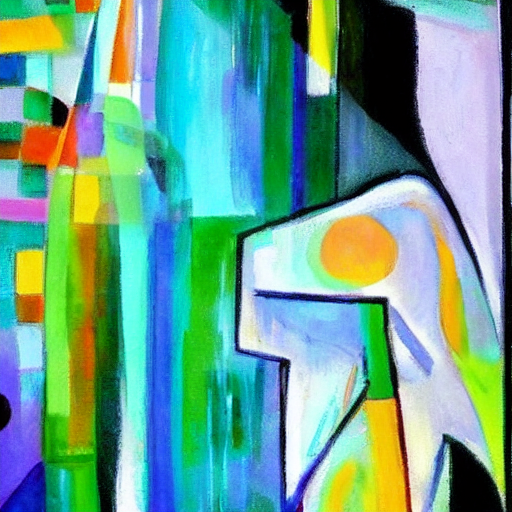

In [15]:
from IPython.display import display


image = generate_image_with_diffusers(sd_1_5_pipe, user_prompt, steps=100)
image.save("user_prompt_generated_stable-diffusion-v1-5.png")

display(image)

#### Генерация изображения с улучшенным промптом с RAG

In [58]:
improved_prompt_gpt

"\nAn abstract 2D illustration featuring a human figure with four distinct, vibrant details in bold colors. The figure is minimalistic yet dynamic, composed of geometric shapes and clean lines, using a color palette of four contrasting tones. No 3D elements or photographic textures. The design follows the brand's visual identity, with no additional effects applied to the VlosaNz typeface or text. The illustration avoids combining multiple color schemes within the same semantic block. The background is simple and enhances the focus on the abstract human figure.\n"

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['. the illustration avoids combining multiple color schemes within the same semantic block . the background is simple and enhances the focus on the abstract human figure .']


  0%|          | 0/100 [00:00<?, ?it/s]

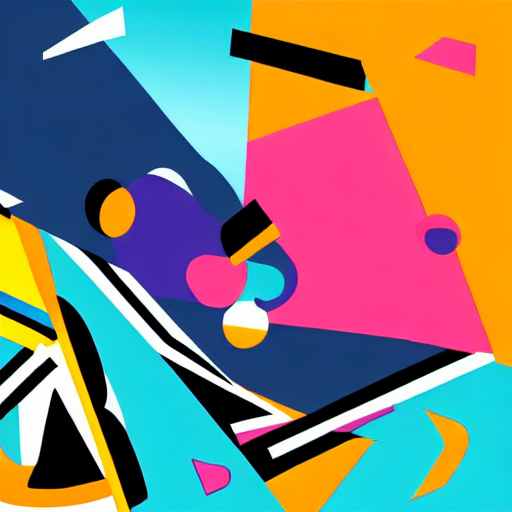

In [59]:
from IPython.display import display


image = generate_image_with_diffusers(sd_1_5_pipe, improved_prompt_gpt, steps=100)
image.save("improved_prompt_generated_stable-diffusion-v1-5.png")

display(image)

#### Модель stable-diffusion-2-1-base

In [6]:
import torch
from diffusers import StableDiffusionPipeline


sd_2_1_pipe = StableDiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-2-1-base").to(device)

model_index.json:   0%|          | 0.00/543 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


scheduler_config.json:   0%|          | 0.00/346 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/613 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/911 [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`
Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


config.json:   0%|          | 0.00/553 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/807 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.36G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.46G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

#### Генерация изображения с промптом без RAG

In [63]:
user_prompt

'I want an abstract person with abstractions in light colors'

  0%|          | 0/100 [00:00<?, ?it/s]

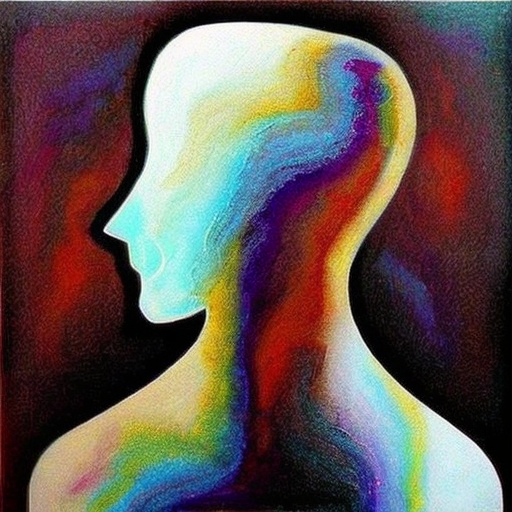

In [61]:
from IPython.display import display


image = generate_image_with_diffusers(sd_2_1_pipe, user_prompt, steps=100)
image.save("user_prompt_generated_stable-diffusion-2-1-base.png")

display(image)

#### Генерация изображения с улучшенным промптом c RAG

In [64]:
improved_prompt_gpt

"\nAn abstract 2D illustration featuring a human figure with four distinct, vibrant details in bold colors. The figure is minimalistic yet dynamic, composed of geometric shapes and clean lines, using a color palette of four contrasting tones. No 3D elements or photographic textures. The design follows the brand's visual identity, with no additional effects applied to the VlosaNz typeface or text. The illustration avoids combining multiple color schemes within the same semantic block. The background is simple and enhances the focus on the abstract human figure.\n"

Token indices sequence length is longer than the specified maximum sequence length for this model (106 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['. the illustration avoids combining multiple color schemes within the same semantic block . the background is simple and enhances the focus on the abstract human figure .']


  0%|          | 0/100 [00:00<?, ?it/s]

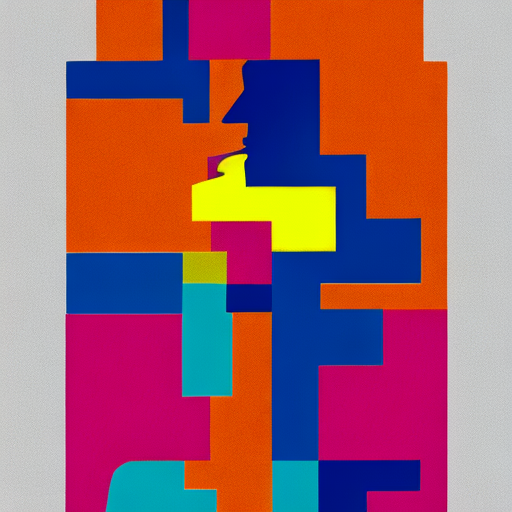

In [62]:
from IPython.display import display


image = generate_image_with_diffusers(sd_2_1_pipe, improved_prompt_gpt, steps=100)
image.save("generated_stable-diffusion-2-1-base.png")

display(image)

#### Модель Kandinsky 2.2

In [16]:
pip install diffusers transformers accelerate

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.2 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.8 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.0 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 4.9 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.3 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.3 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 80.2 MB/s eta 0:00:00:00:0100:01
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.8.93
    Uninstalling nvidia-nvjitlink-cu12-12.8.93:
      Successfully uninstalled nvidia-nvjitlink-cu12-12.8.93
  Attempting uninstall: nvidia-curand-cu12
    Found existing installation: nvidia-curand-cu12 10.3.9.90
    Uninstalling nvidia-curand-cu12-1

In [4]:
from diffusers import AutoPipelineForText2Image


kandinsky_pipe = AutoPipelineForText2Image.from_pretrained("kandinsky-community/kandinsky-2-2-decoder", torch_dtype=torch.float16).to(device)

2025-05-19 09:47:30.345763: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1747648050.536742      31 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1747648050.594766      31 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


model_index.json:   0%|          | 0.00/250 [00:00<?, ?B/s]

Fetching 7 files:   0%|          | 0/7 [00:00<?, ?it/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/271M [00:00<?, ?B/s]

README.md:   0%|          | 0.00/7.34k [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/317 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/5.01G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.67k [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/3 [00:00<?, ?it/s]

model_index.json:   0%|          | 0.00/501 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

model.safetensors:   0%|          | 0.00/3.69G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/4.10G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/2.01k [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/315 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/229 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/252 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/2.02k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/904 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/862k [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

#### Генерация изображения с промптом без RAG

In [66]:
user_prompt

'I want an abstract person with abstractions in light colors'

  0%|          | 0/100 [00:00<?, ?it/s]

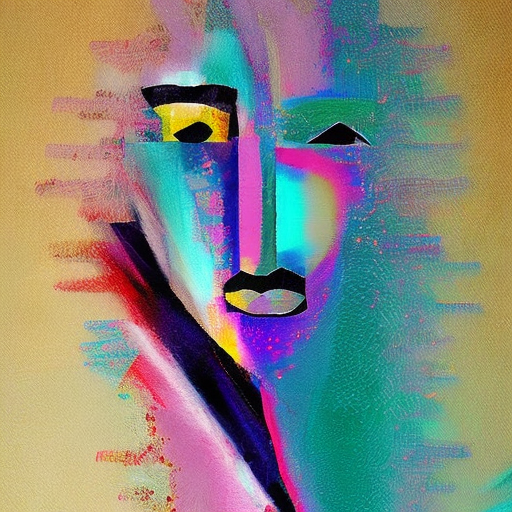

In [67]:
from IPython.display import display


image = generate_image_with_diffusers(kandinsky_pipe, user_prompt, steps=100)
image.save("user_prompt_generated_kandinsky-2-2-decoder.png")

display(image)

#### Генерация изображения с улучшенным промптом с RAG

In [68]:
improved_prompt_gpt

"\nAn abstract 2D illustration featuring a human figure with four distinct, vibrant details in bold colors. The figure is minimalistic yet dynamic, composed of geometric shapes and clean lines, using a color palette of four contrasting tones. No 3D elements or photographic textures. The design follows the brand's visual identity, with no additional effects applied to the VlosaNz typeface or text. The illustration avoids combining multiple color schemes within the same semantic block. The background is simple and enhances the focus on the abstract human figure.\n"

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['. the illustration avoids combining multiple color schemes within the same semantic block . the background is simple and enhances the focus on the abstract human figure .']


  0%|          | 0/100 [00:00<?, ?it/s]

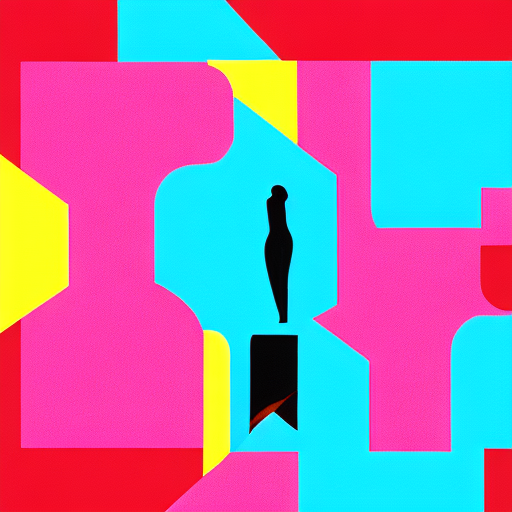

In [69]:
from IPython.display import display


image = generate_image_with_diffusers(kandinsky_pipe, improved_prompt_gpt, steps=100)
image.save("generated_kandinsky-2-2-decoder.png")

display(image)

## 4. Оценка метрик качества

#### 4.1 Image-Text Matching (ITM)

Здесь мы оцениваем соответствие сгенерированных изображений исходному текстовому описанию с помощью метрики Image-Text Matching, основанной на модели BLIP. Она возвращает вероятность в диапазоне от 0 до 1, отражающую степень семантического соответствия изображения и текста.

Проведем исследование и сравним `BLIP score` для "сырых" пользовательских промптов и улучшенных с помощью `RAG`.

In [1]:
raw_user_prompts = (
    "Generate a calm abstract landscape in soft pastel tones",
    "Show dynamic geometric shapes interacting in a minimal composition",
    "Create a visual metaphor for growth and progress using minimal abstract forms and a calm corporate palette.",
    "Illustrate a futuristic workspace concept with clean lines, abstract people, and harmonious light colors.",
    "Create a futuristic abstract city in flat 2D style",
    "Visualize a human figure connecting with technology through light-colored geometric abstraction.",
    "Design a conceptual image of collaboration using line art",
    "Create a visual metaphor for clarity and focus, minimal style",
    "Depict energy and movement using simple shapes and flat design",
    "Create a futuristic abstract city in flat 2D style",
)

#### Генерация списка улучшенных системных промптов

In [46]:
system_prompts = []

for user_prompt in raw_user_prompts:
    relevant_guidelines = search_similar(
        guideline_content=guideline_content,
        user_prompt=user_prompt,
        embed_model=embed_model,
        faiss_index=guideline_index
    )
    
    image_captions = search_similar(
        guideline_content=blip_pro_df["caption"],
        user_prompt=user_prompt,
        embed_model=embed_model,
        faiss_index=blip_pro_index
    )

    guidelines_str = "\n".join(relevant_guidelines)
    captions_str = "\n".join(image_captions)
    
    system_prompt = f"""
        You are a creative assistant that transforms user image requests into refined, brand-consistent prompts for Stable Diffusion. Your goal is to generate a final visual prompt that strictly follows brand guidelines and emphasizes clarity, structure, and stylistic consistency.
        
        Your task:
        1. Read the user input describing the desired visual.
        2. Use the brand guidelines to ensure the prompt follows the company’s visual identity.
        3. Use the example image descriptions as inspiration for tone, structure, and stylistic direction.
        4. Output a final, standalone prompt that can be used directly with Stable Diffusion.
        
        Requirements:
        - The prompt must be written in clear, professional English.
        - It should describe a minimalistic, abstract, and brand-consistent image.
        - Do not include any instructions, explanations, or brand guideline text in the final output.
        - Avoid photographic elements, 3D features, or effects prohibited by the brand.
        - Limit the number of colors if required, and use flat design principles.
        
        Inputs:
        
        User input:
        "{user_prompt}"
        
        Relevant brand guidelines:
        {guidelines_str}
        
        Example image descriptions:
        {captions_str}
        
        Output:
        Return only the final refined prompt suitable for Stable Diffusion.
        """
    system_prompts.append(system_prompt)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

In [49]:
system_prompts[9]

'\n        You are a creative assistant that transforms user image requests into refined, brand-consistent prompts for Stable Diffusion. Your goal is to generate a final visual prompt that strictly follows brand guidelines and emphasizes clarity, structure, and stylistic consistency.\n        \n        Your task:\n        1. Read the user input describing the desired visual.\n        2. Use the brand guidelines to ensure the prompt follows the company’s visual identity.\n        3. Use the example image descriptions as inspiration for tone, structure, and stylistic direction.\n        4. Output a final, standalone prompt that can be used directly with Stable Diffusion.\n        \n        Requirements:\n        - The prompt must be written in clear, professional English.\n        - It should describe a minimalistic, abstract, and brand-consistent image.\n        - Do not include any instructions, explanations, or brand guideline text in the final output.\n        - Avoid photographic el

### Пояснение (!)
Далее нам необходимо улучшить промпт с помощью `LLM`. Но так как технической возможности развернуть `LLM` в `kaggle` нет, то на этапе `baseline`
будем использовать готовый промпт от `ChatGPT`.

На финальной же защите проекта у итогового сервиса будет доступ до `HGX` кластера с развернутой нами `LLM (llama-3.3-70b)` в `Triton Inference Server`.

In [15]:
gpt_improved_prompts = (
    "A serene abstract landscape composed of soft pastel tones. Gentle, flowing forms suggest distant hills and open space, rendered with flat, muted colors and minimal detail. The composition is balanced and uncluttered, evoking calm and clarity while maintaining a distinctly modern and brand-aligned visual tone.",
    "A minimal composition of dynamic geometric shapes in soft, muted tones. Rounded rectangles, circles, and angular forms interact with subtle overlap and spacing, arranged in a balanced layout on a neutral background. The scene is rendered in flat design with no gradients or shadows, using a front-facing or isometric perspective to suggest motion and tension within a calm, abstract space.",
    "An abstract minimalistic composition symbolizing growth and progress through gently ascending geometric forms with rounded corners. Shapes are arranged in a balanced, harmonious layout using a calm corporate color palette of muted blues and soft grays. The design employs flat colors without gradients or shadows, presented in a front-facing or subtle isometric perspective, conveying steady upward movement and purposeful development within a clean, modern space.",
    "A minimalistic 2D abstract illustration of a futuristic workspace featuring clean, precise lines and simplified, stylized human figures. The composition uses a harmonious palette of soft pastel colors limited to four tones, with flat shapes and subtle outlines. The layout is balanced and geometric, emphasizing clarity and calmness, avoiding photographic or 3D effects, and maintaining a modern, corporate aesthetic.",
    "A minimalistic flat 2D illustration of a futuristic abstract cityscape with rounded corners and soft edges. The design features clean geometric shapes arranged in an isometric perspective, using a limited palette of three harmonious pastel colors. The composition is balanced and smooth, with no sharp contrasts or photographic elements, emphasizing simplicity and brand-consistent clarity.",
    "A minimalistic flat 2D illustration of a human figure abstractly connected with technology through soft, light-colored geometric shapes. The design features smooth rounded corners and balanced composition in an isometric style, using a limited palette of three harmonious pastel tones. The image emphasizes clarity and simplicity with subtle contrasts and clean lines, avoiding photographic or 3D effects.",
    "A minimalistic flat 2D line art illustration symbolizing collaboration, composed of interconnected abstract shapes with smooth rounded corners. The design uses a restrained palette of three soft, harmonious colors with subtle contrasts. The composition is clean and balanced, rendered in an isometric or front-facing style, emphasizing clarity and simplicity without photographic or 3D elements.",
    "A minimalistic flat 2D abstract illustration representing clarity and focus, featuring smooth, rounded shapes arranged in a balanced composition. The design employs a limited palette of soft, muted colors with gentle contrasts, rendered in an isometric or front-facing style. The image is clean, structured, and adheres to flat design principles without any photographic or 3D effects.",
    "A minimalistic flat 2D abstract illustration of a futuristic cityscape composed of smooth, rounded geometric shapes symbolizing energy and movement. The composition features balanced isometric or front-facing perspectives, using a limited palette of soft, muted colors with gentle contrasts. The design emphasizes clean lines, simplicity, and flat design principles without photographic or 3D effects.",
    "A minimalistic flat 2D illustration of a futuristic abstract city composed of smooth, rounded geometric shapes with soft, muted colors and gentle contrasts. The design features balanced isometric or front-facing perspectives, clean lines, and a harmonious composition emphasizing simplicity and softness without photographic or 3D elements.",
)

#### Загрузка `ITM` модели на устройство

In [10]:
from transformers import BlipProcessor, BlipForImageTextRetrieval


processor = BlipProcessor.from_pretrained("Salesforce/blip-itm-base-coco")
model = BlipForImageTextRetrieval.from_pretrained("Salesforce/blip-itm-base-coco").to(device)

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


preprocessor_config.json:   0%|          | 0.00/445 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/456 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/711k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/125 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.56k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/895M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/895M [00:00<?, ?B/s]

In [8]:
from PIL import Image


def blip_similarity(image_path: str, text_prompt: str) -> float:
    image = Image.open(image_path).convert('RGB')
    inputs = processor(images=image, text=text_prompt, return_tensors="pt").to(device)
    
    with torch.no_grad():
        outputs = model(**inputs)
    
    logits = outputs.itm_score
    probs = torch.softmax(logits, dim=1)
    similarity_score = probs[0][1].item()

    return similarity_score

#### Генерация изображений по улучшенным промптам для модели `stable-diffusion-v1-5`

  0%|          | 0/100 [00:00<?, ?it/s]

'A serene abstract landscape composed of soft pastel tones. Gentle, flowing forms suggest distant hills and open space, rendered with flat, muted colors and minimal detail. The composition is balanced and uncluttered, evoking calm and clarity while maintaining a distinctly modern and brand-aligned visual tone.'

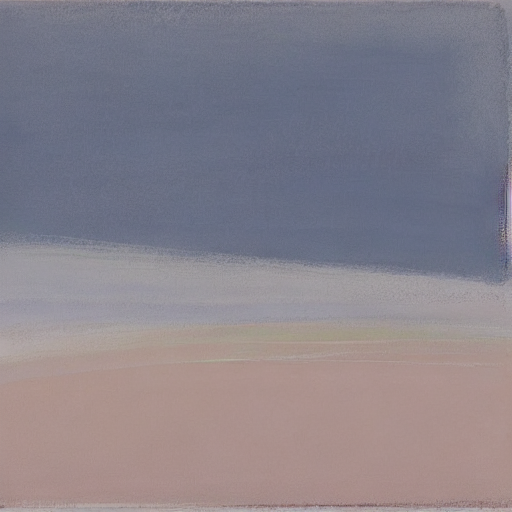

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['abstract space .']


  0%|          | 0/100 [00:00<?, ?it/s]

'A minimal composition of dynamic geometric shapes in soft, muted tones. Rounded rectangles, circles, and angular forms interact with subtle overlap and spacing, arranged in a balanced layout on a neutral background. The scene is rendered in flat design with no gradients or shadows, using a front-facing or isometric perspective to suggest motion and tension within a calm, abstract space.'

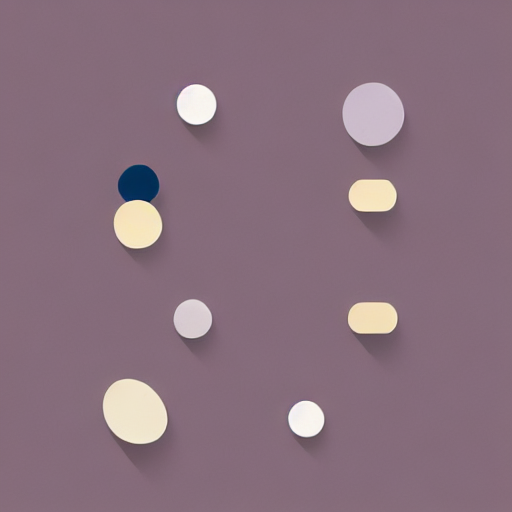

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ful development within a clean , modern space .']


  0%|          | 0/100 [00:00<?, ?it/s]

'An abstract minimalistic composition symbolizing growth and progress through gently ascending geometric forms with rounded corners. Shapes are arranged in a balanced, harmonious layout using a calm corporate color palette of muted blues and soft grays. The design employs flat colors without gradients or shadows, presented in a front-facing or subtle isometric perspective, conveying steady upward movement and purposeful development within a clean, modern space.'

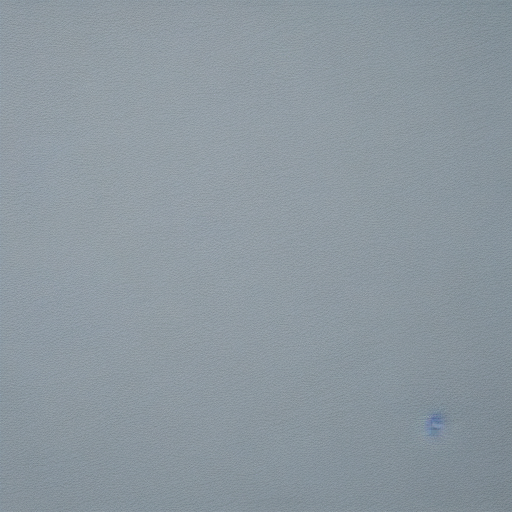

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['.']


  0%|          | 0/100 [00:00<?, ?it/s]

'A minimalistic 2D abstract illustration of a futuristic workspace featuring clean, precise lines and simplified, stylized human figures. The composition uses a harmonious palette of soft pastel colors limited to four tones, with flat shapes and subtle outlines. The layout is balanced and geometric, emphasizing clarity and calmness, avoiding photographic or 3D effects, and maintaining a modern, corporate aesthetic.'

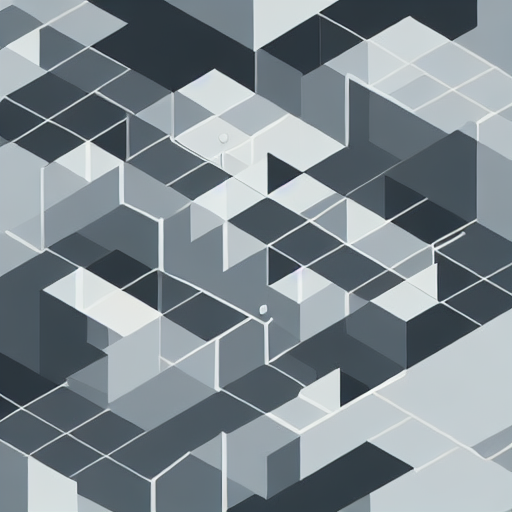

  0%|          | 0/100 [00:00<?, ?it/s]

'A minimalistic flat 2D illustration of a futuristic abstract cityscape with rounded corners and soft edges. The design features clean geometric shapes arranged in an isometric perspective, using a limited palette of three harmonious pastel colors. The composition is balanced and smooth, with no sharp contrasts or photographic elements, emphasizing simplicity and brand-consistent clarity.'

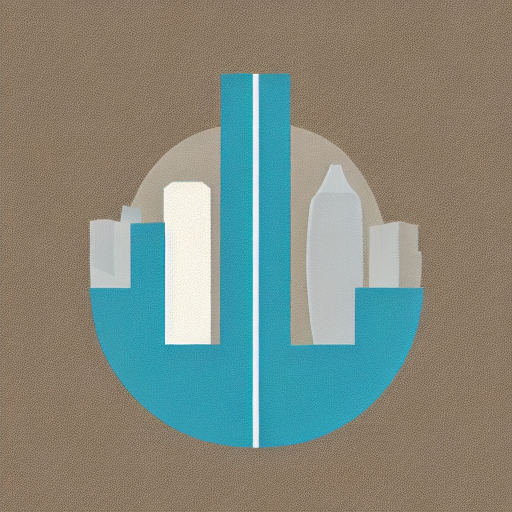

  0%|          | 0/100 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


'A minimalistic flat 2D illustration of a human figure abstractly connected with technology through soft, light-colored geometric shapes. The design features smooth rounded corners and balanced composition in an isometric style, using a limited palette of three harmonious pastel tones. The image emphasizes clarity and simplicity with subtle contrasts and clean lines, avoiding photographic or 3D effects.'

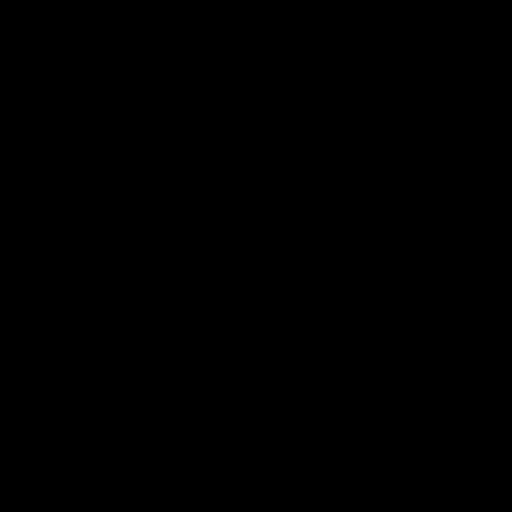

  0%|          | 0/100 [00:00<?, ?it/s]

'A minimalistic flat 2D line art illustration symbolizing collaboration, composed of interconnected abstract shapes with smooth rounded corners. The design uses a restrained palette of three soft, harmonious colors with subtle contrasts. The composition is clean and balanced, rendered in an isometric or front-facing style, emphasizing clarity and simplicity without photographic or 3D elements.'

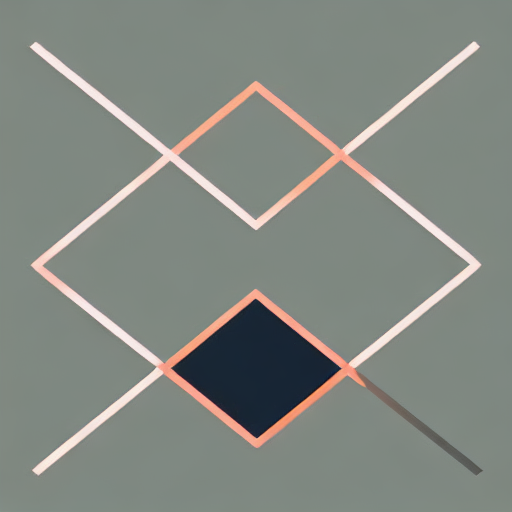

  0%|          | 0/100 [00:00<?, ?it/s]

'A minimalistic flat 2D abstract illustration representing clarity and focus, featuring smooth, rounded shapes arranged in a balanced composition. The design employs a limited palette of soft, muted colors with gentle contrasts, rendered in an isometric or front-facing style. The image is clean, structured, and adheres to flat design principles without any photographic or 3D effects.'

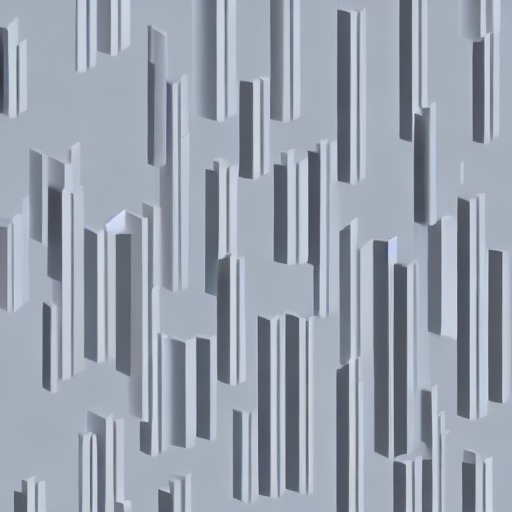

  0%|          | 0/100 [00:00<?, ?it/s]

'A minimalistic flat 2D abstract illustration of a futuristic cityscape composed of smooth, rounded geometric shapes symbolizing energy and movement. The composition features balanced isometric or front-facing perspectives, using a limited palette of soft, muted colors with gentle contrasts. The design emphasizes clean lines, simplicity, and flat design principles without photographic or 3D effects.'

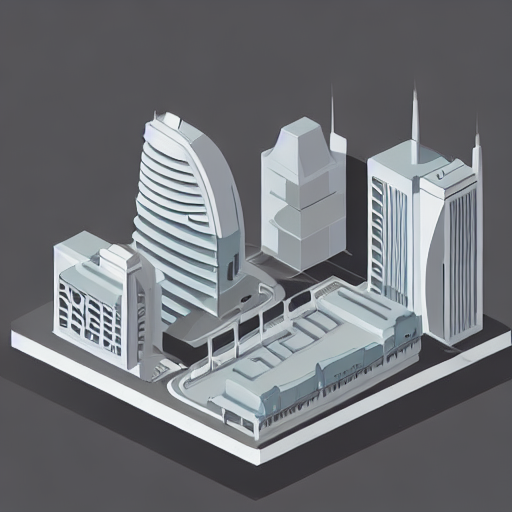

  0%|          | 0/100 [00:00<?, ?it/s]

'A minimalistic flat 2D illustration of a futuristic abstract city composed of smooth, rounded geometric shapes with soft, muted colors and gentle contrasts. The design features balanced isometric or front-facing perspectives, clean lines, and a harmonious composition emphasizing simplicity and softness without photographic or 3D elements.'

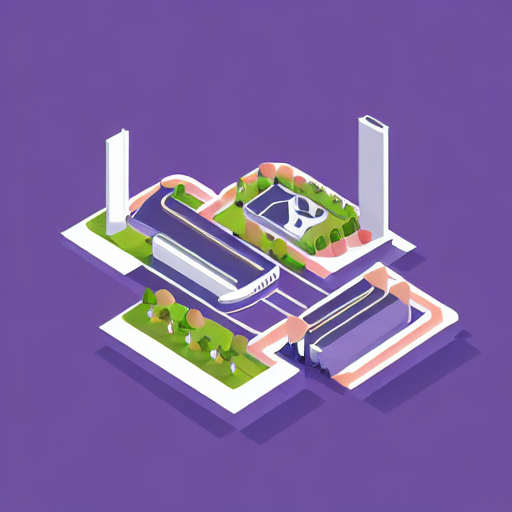

In [28]:
from IPython.display import display


for idx, prompt in enumerate(gpt_improved_prompts):
    image = generate_image_with_diffusers(sd_1_5_pipe, prompt, steps=100)
    image.save(f"stable-diffusion-v1-5_improved_{idx}_generated.png")
    display(prompt, image)

Из-за того что сработало `Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.` для `5` индекса промпта, сделаем повторную генерацию отдельно

  0%|          | 0/100 [00:00<?, ?it/s]

'A minimalistic flat 2D illustration of a human figure abstractly connected with technology through soft, light-colored geometric shapes. The design features smooth rounded corners and balanced composition in an isometric style, using a limited palette of three harmonious pastel tones. The image emphasizes clarity and simplicity with subtle contrasts and clean lines, avoiding photographic or 3D effects.'

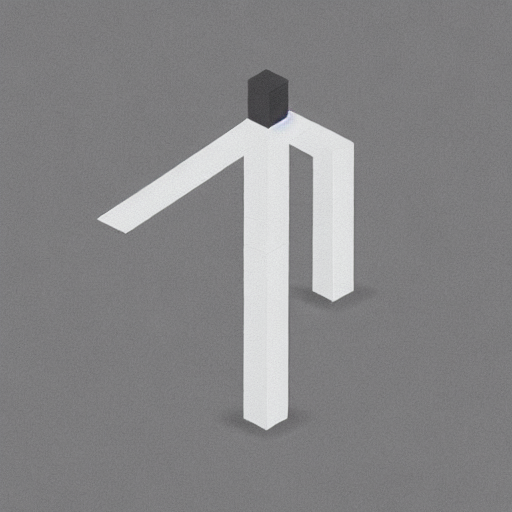

In [29]:
prompt = gpt_improved_prompts[5]

image = generate_image_with_diffusers(sd_1_5_pipe, prompt, steps=100)
image.save(f"stable-diffusion-v1-5_improved_5_generated.png")
display(prompt, image)

#### Подсчет `BLIP` score для изображений с улучшенным `RAG` промптом.

In [33]:
# Загрузка сгенерированных изображений
from pathlib import Path


improved_diffusion_1_5_img_paths = sorted(list(Path("/kaggle/input/output/output/stable-diffusion-v1-5/improved").iterdir()))

In [34]:
improved_diffusion_1_5_blip_scores = []

for img_path, prompt in zip(improved_diffusion_1_5_img_paths, gpt_improved_prompts):
    score = blip_similarity(img_path, prompt)
    improved_diffusion_1_5_blip_scores.append(score)

In [35]:
improved_diffusion_1_5_blip_scores

[0.9519234895706177,
 0.9957072734832764,
 0.4915216267108917,
 0.0028219809755682945,
 0.9990227222442627,
 0.9930205941200256,
 0.7115712761878967,
 0.1657174527645111,
 0.9959266185760498,
 0.9943267703056335]

#### Генерация изображений c промптам без `RAG` для модели `stable-diffusion-v1-5`

  0%|          | 0/100 [00:00<?, ?it/s]

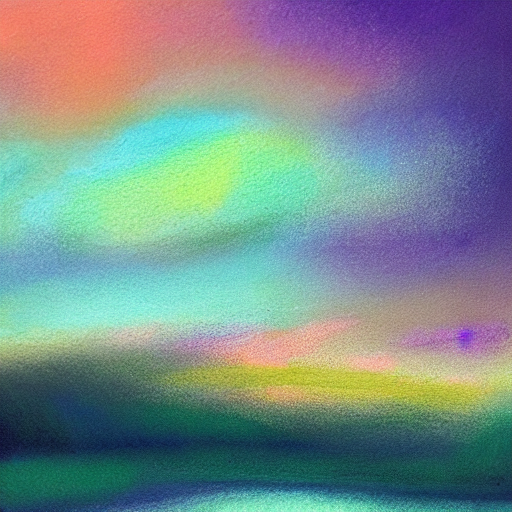

  0%|          | 0/100 [00:00<?, ?it/s]

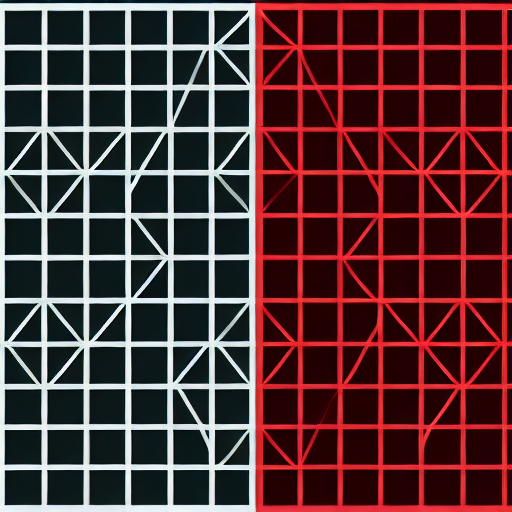

  0%|          | 0/100 [00:00<?, ?it/s]

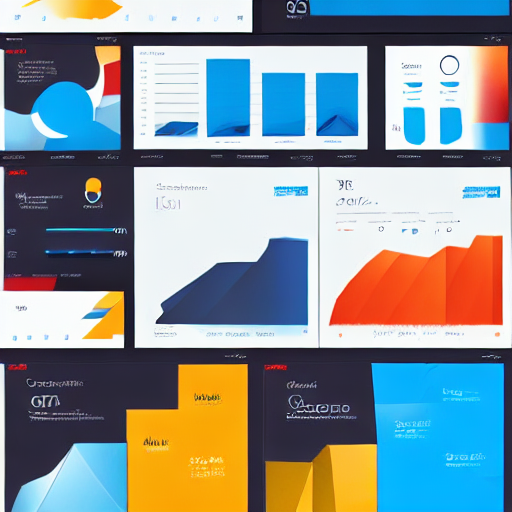

  0%|          | 0/100 [00:00<?, ?it/s]

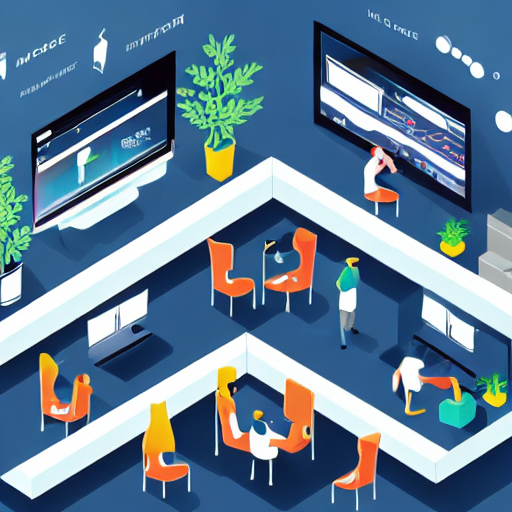

  0%|          | 0/100 [00:00<?, ?it/s]

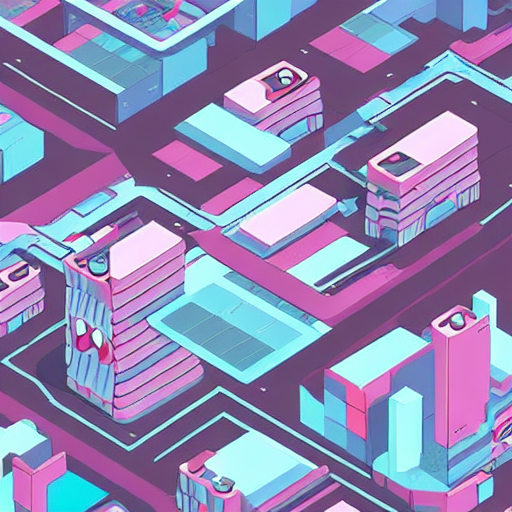

  0%|          | 0/100 [00:00<?, ?it/s]

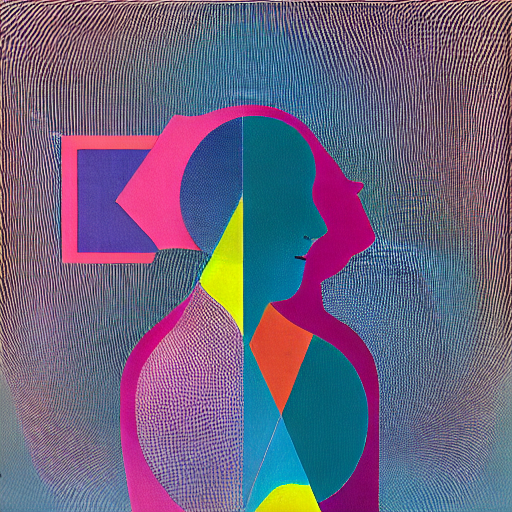

  0%|          | 0/100 [00:00<?, ?it/s]

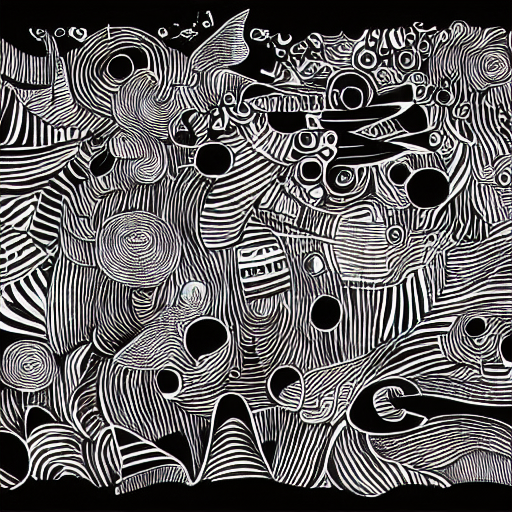

  0%|          | 0/100 [00:00<?, ?it/s]

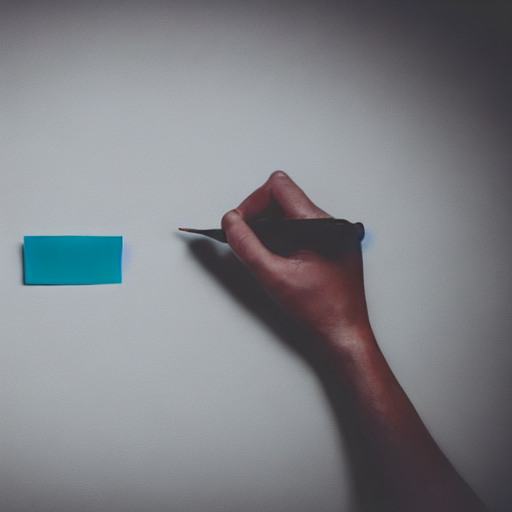

  0%|          | 0/100 [00:00<?, ?it/s]

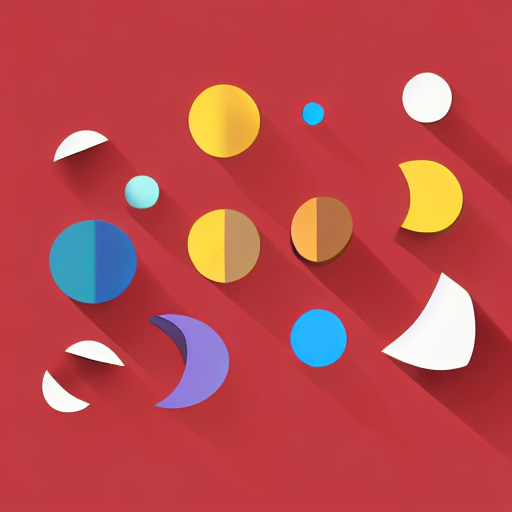

  0%|          | 0/100 [00:00<?, ?it/s]

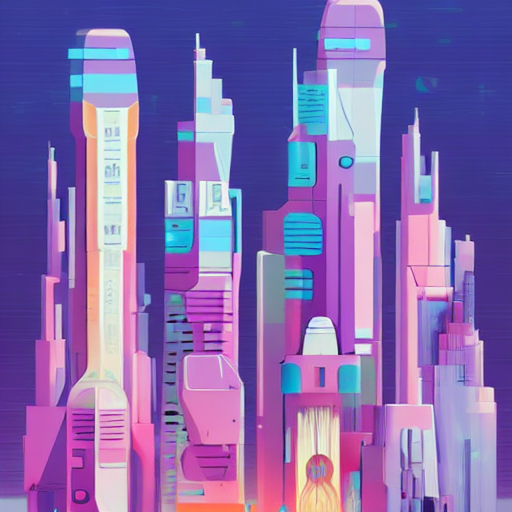

In [17]:
from IPython.display import display


for idx, prompt in enumerate(raw_user_prompts):
    image = generate_image_with_diffusers(sd_1_5_pipe, prompt, steps=100)
    image.save(f"stable-diffusion-v1-5_raw_{idx}_generated.png")
    display(prompt, image)

#### Подсчет `BLIP` score для изображений с промптами без `RAG`.

In [38]:
# Загрузка сгенерированных изображений
from pathlib import Path


raw_diffusion_1_5_img_paths = sorted(list(Path("/kaggle/input/output/output/stable-diffusion-v1-5/raw").iterdir()))

In [39]:
diffusion_1_5_blip_scores = []

for img_path, prompt in zip(raw_diffusion_1_5_img_paths, raw_user_prompts):
    score = blip_similarity(img_path, prompt)
    diffusion_1_5_blip_scores.append(score)

In [40]:
diffusion_1_5_blip_scores

[0.9935104250907898,
 0.19178365170955658,
 0.9517565369606018,
 0.91245037317276,
 0.99953293800354,
 0.8986406326293945,
 0.9353732466697693,
 0.6446101069450378,
 0.735687792301178,
 0.9995526671409607]

#### Подсчет средних значений `BLIP` scores

In [58]:
mean_raw_diffusion_1_5 = sum(diffusion_1_5_blip_scores) / len(diffusion_1_5_blip_scores)
mean_improved_diffusion_1_5 = sum(improved_diffusion_1_5_blip_scores) / len(improved_diffusion_1_5_blip_scores)

print(f"Mean user prompt scores: {round(mean_raw_diffusion_1_5, 3)}\nMean improved prompt scores: {round(mean_improved_diffusion_1_5, 3)}")

Mean user prompt scores: 0.826
Mean improved prompt scores: 0.73


#### Генерация изображений по улучшенным промптам для модели `stable-diffusion-2-1-base`

  0%|          | 0/100 [00:00<?, ?it/s]

'A serene abstract landscape composed of soft pastel tones. Gentle, flowing forms suggest distant hills and open space, rendered with flat, muted colors and minimal detail. The composition is balanced and uncluttered, evoking calm and clarity while maintaining a distinctly modern and brand-aligned visual tone.'

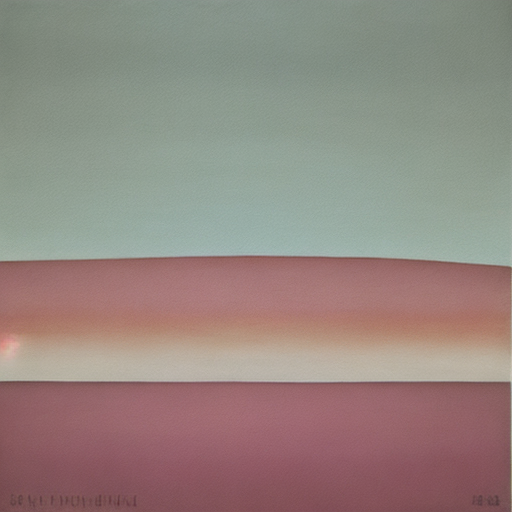

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['abstract space .']


  0%|          | 0/100 [00:00<?, ?it/s]

'A minimal composition of dynamic geometric shapes in soft, muted tones. Rounded rectangles, circles, and angular forms interact with subtle overlap and spacing, arranged in a balanced layout on a neutral background. The scene is rendered in flat design with no gradients or shadows, using a front-facing or isometric perspective to suggest motion and tension within a calm, abstract space.'

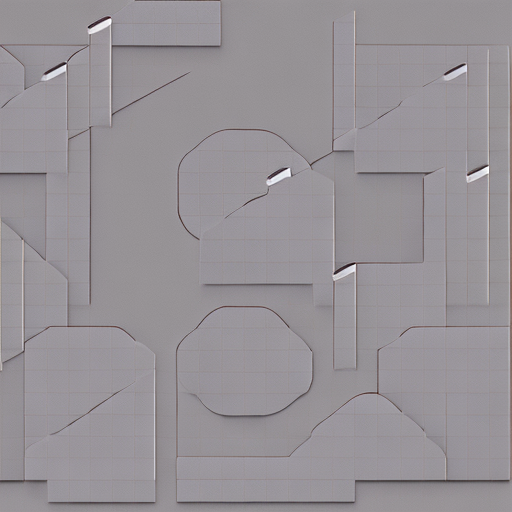

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ful development within a clean , modern space .']


  0%|          | 0/100 [00:00<?, ?it/s]

'An abstract minimalistic composition symbolizing growth and progress through gently ascending geometric forms with rounded corners. Shapes are arranged in a balanced, harmonious layout using a calm corporate color palette of muted blues and soft grays. The design employs flat colors without gradients or shadows, presented in a front-facing or subtle isometric perspective, conveying steady upward movement and purposeful development within a clean, modern space.'

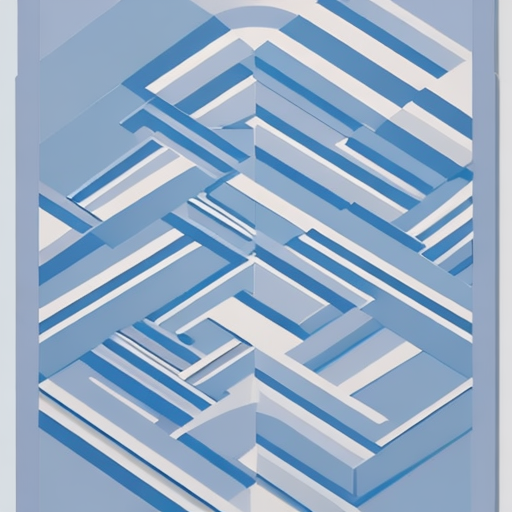

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['.']


  0%|          | 0/100 [00:00<?, ?it/s]

'A minimalistic 2D abstract illustration of a futuristic workspace featuring clean, precise lines and simplified, stylized human figures. The composition uses a harmonious palette of soft pastel colors limited to four tones, with flat shapes and subtle outlines. The layout is balanced and geometric, emphasizing clarity and calmness, avoiding photographic or 3D effects, and maintaining a modern, corporate aesthetic.'

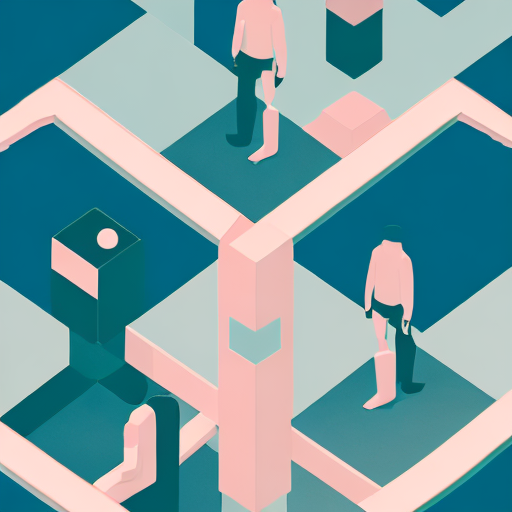

  0%|          | 0/100 [00:00<?, ?it/s]

'A minimalistic flat 2D illustration of a futuristic abstract cityscape with rounded corners and soft edges. The design features clean geometric shapes arranged in an isometric perspective, using a limited palette of three harmonious pastel colors. The composition is balanced and smooth, with no sharp contrasts or photographic elements, emphasizing simplicity and brand-consistent clarity.'

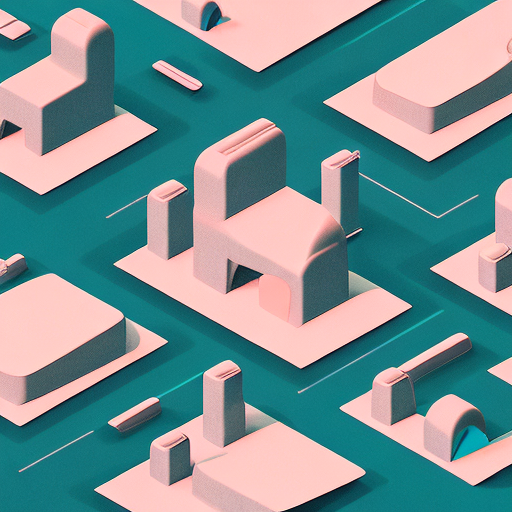

  0%|          | 0/100 [00:00<?, ?it/s]

'A minimalistic flat 2D illustration of a human figure abstractly connected with technology through soft, light-colored geometric shapes. The design features smooth rounded corners and balanced composition in an isometric style, using a limited palette of three harmonious pastel tones. The image emphasizes clarity and simplicity with subtle contrasts and clean lines, avoiding photographic or 3D effects.'

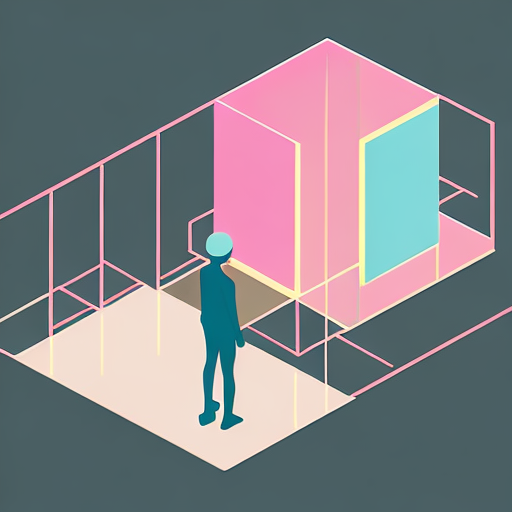

  0%|          | 0/100 [00:00<?, ?it/s]

'A minimalistic flat 2D line art illustration symbolizing collaboration, composed of interconnected abstract shapes with smooth rounded corners. The design uses a restrained palette of three soft, harmonious colors with subtle contrasts. The composition is clean and balanced, rendered in an isometric or front-facing style, emphasizing clarity and simplicity without photographic or 3D elements.'

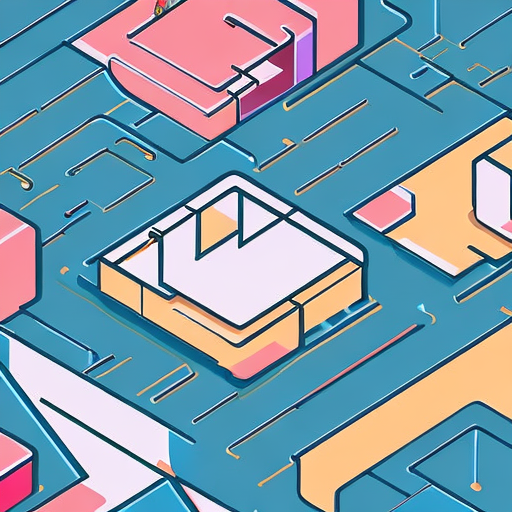

  0%|          | 0/100 [00:00<?, ?it/s]

'A minimalistic flat 2D abstract illustration representing clarity and focus, featuring smooth, rounded shapes arranged in a balanced composition. The design employs a limited palette of soft, muted colors with gentle contrasts, rendered in an isometric or front-facing style. The image is clean, structured, and adheres to flat design principles without any photographic or 3D effects.'

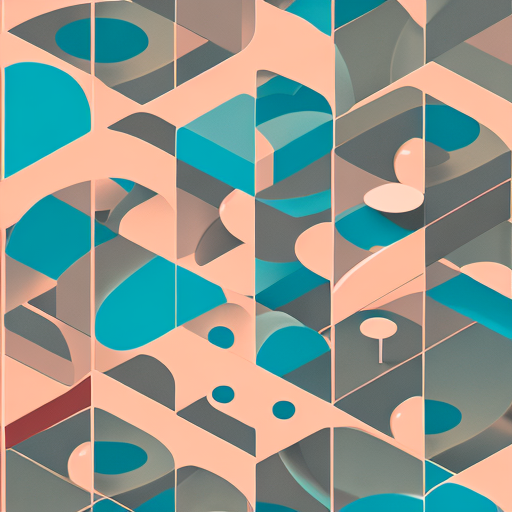

  0%|          | 0/100 [00:00<?, ?it/s]

'A minimalistic flat 2D abstract illustration of a futuristic cityscape composed of smooth, rounded geometric shapes symbolizing energy and movement. The composition features balanced isometric or front-facing perspectives, using a limited palette of soft, muted colors with gentle contrasts. The design emphasizes clean lines, simplicity, and flat design principles without photographic or 3D effects.'

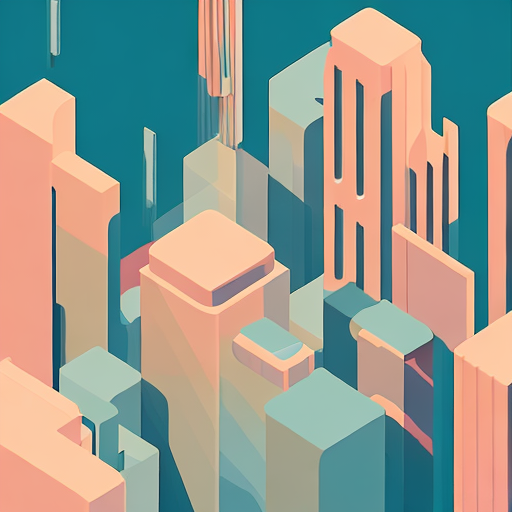

  0%|          | 0/100 [00:00<?, ?it/s]

'A minimalistic flat 2D illustration of a futuristic abstract city composed of smooth, rounded geometric shapes with soft, muted colors and gentle contrasts. The design features balanced isometric or front-facing perspectives, clean lines, and a harmonious composition emphasizing simplicity and softness without photographic or 3D elements.'

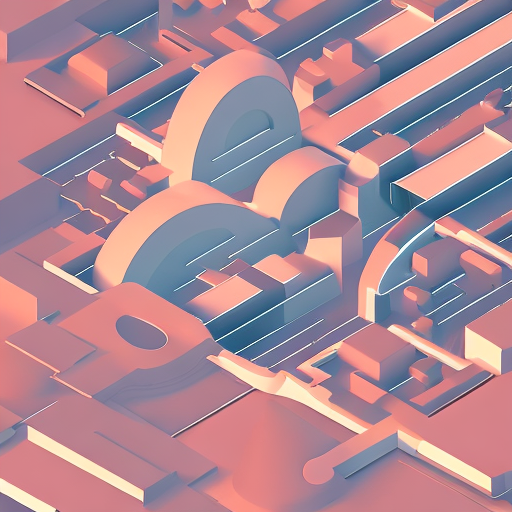

In [8]:
from IPython.display import display


for idx, prompt in enumerate(gpt_improved_prompts):
    image = generate_image_with_diffusers(sd_2_1_pipe, prompt, steps=100)
    image.save(f"stable-diffusion-2-1-improved_{idx}_generated.png")
    display(prompt, image)

#### Подсчет `BLIP` score для изображений с улучшенным `RAG` промптом.

In [42]:
# Загрузка сгенерированных изображений
from pathlib import Path


improved_diffusion_2_1_img_paths = sorted(list(Path("/kaggle/input/output/output/stable-diffusion-2-1-base/improved").iterdir()))

In [43]:
improved_diffusion_2_1_blip_scores = []

for img_path, prompt in zip(improved_diffusion_2_1_img_paths, gpt_improved_prompts):
    score = blip_similarity(img_path, prompt)
    improved_diffusion_2_1_blip_scores.append(score)

In [44]:
improved_diffusion_2_1_blip_scores

[0.9395884275436401,
 0.9896641373634338,
 0.8801222443580627,
 0.6502897143363953,
 0.9995050430297852,
 0.9991543292999268,
 0.976141095161438,
 0.6365941762924194,
 0.9997362494468689,
 0.9983745813369751]

#### Генерация изображений c промптами без `RAG` для модели `stable-diffusion-2-1-base`

  0%|          | 0/100 [00:00<?, ?it/s]

'Generate a calm abstract landscape in soft pastel tones'

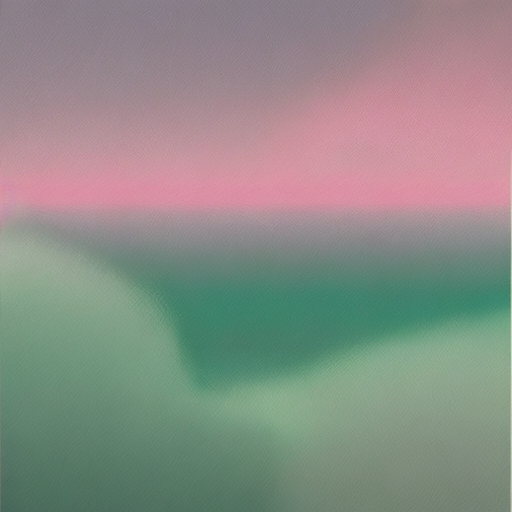

  0%|          | 0/100 [00:00<?, ?it/s]

'Show dynamic geometric shapes interacting in a minimal composition'

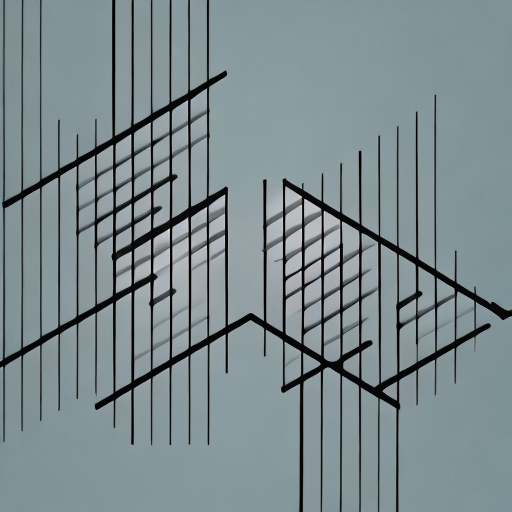

  0%|          | 0/100 [00:00<?, ?it/s]

'Create a visual metaphor for growth and progress using minimal abstract forms and a calm corporate palette.'

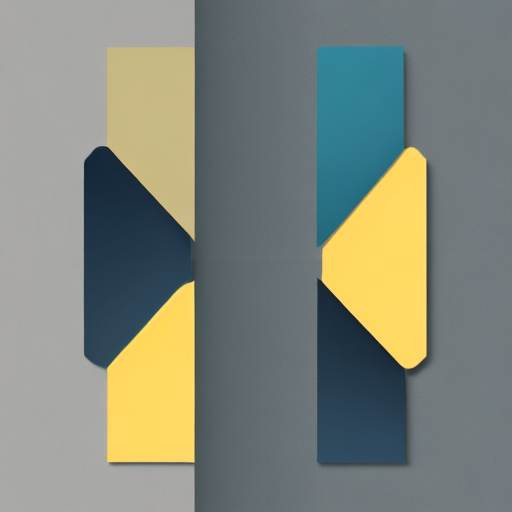

  0%|          | 0/100 [00:00<?, ?it/s]

'Illustrate a futuristic workspace concept with clean lines, abstract people, and harmonious light colors.'

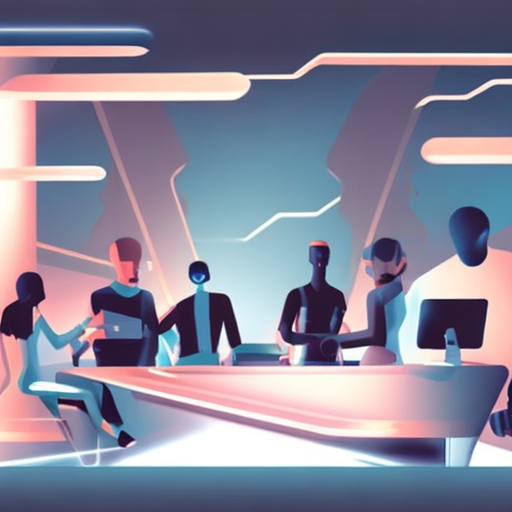

  0%|          | 0/100 [00:00<?, ?it/s]

'Create a futuristic abstract city in flat 2D style'

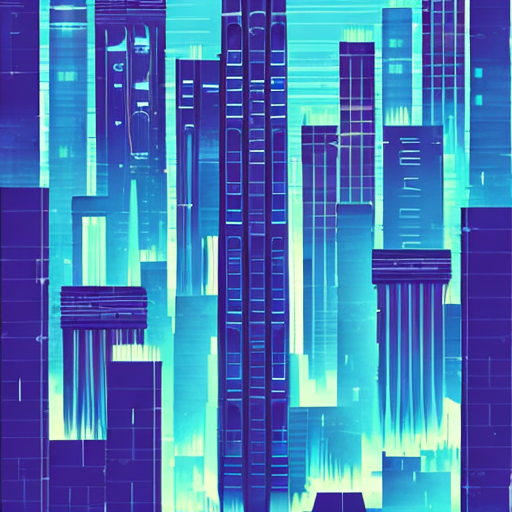

  0%|          | 0/100 [00:00<?, ?it/s]

'Visualize a human figure connecting with technology through light-colored geometric abstraction.'

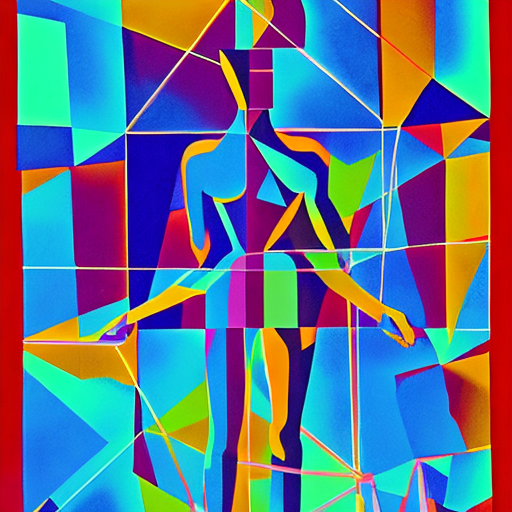

  0%|          | 0/100 [00:00<?, ?it/s]

'Design a conceptual image of collaboration using line art'

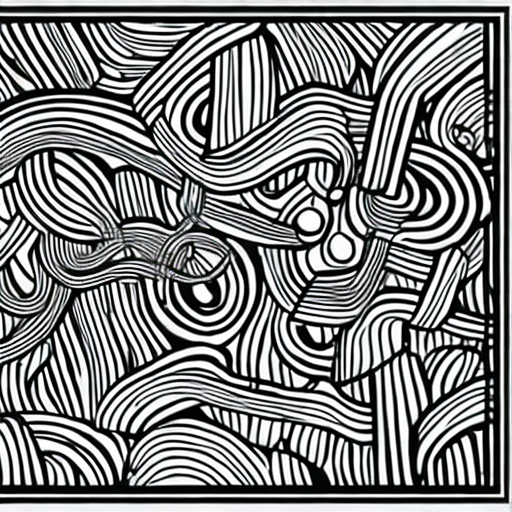

  0%|          | 0/100 [00:00<?, ?it/s]

'Create a visual metaphor for clarity and focus, minimal style'

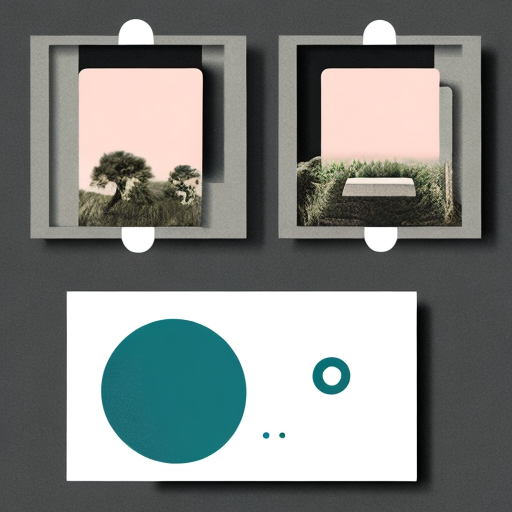

  0%|          | 0/100 [00:00<?, ?it/s]

'Depict energy and movement using simple shapes and flat design'

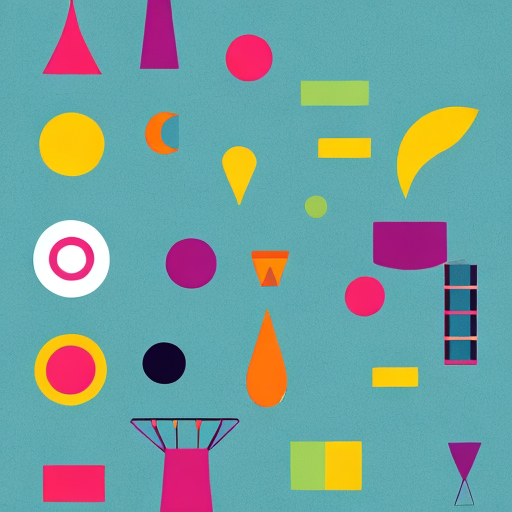

  0%|          | 0/100 [00:00<?, ?it/s]

'Create a futuristic abstract city in flat 2D style'

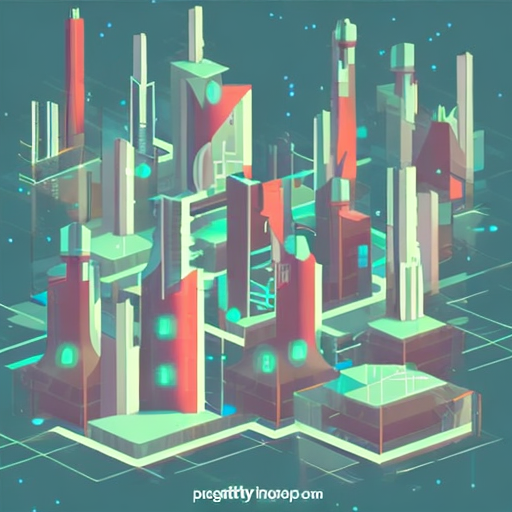

In [7]:
from IPython.display import display


for idx, prompt in enumerate(raw_user_prompts):
    image = generate_image_with_diffusers(sd_2_1_pipe, prompt, steps=100)
    image.save(f"stable-diffusion-2-1-raw_{idx}_generated.png")
    display(prompt, image)

In [46]:
# Загрузка сгенерированных изображений
from pathlib import Path


raw_diffusion_2_1_img_paths = sorted(list(Path("/kaggle/input/output/output/stable-diffusion-2-1-base/raw").iterdir()))

In [47]:
diffusion_2_1_blip_scores = []

for img_path, prompt in zip(raw_diffusion_2_1_img_paths, raw_user_prompts):
    score = blip_similarity(img_path, prompt)
    diffusion_2_1_blip_scores.append(score)

In [48]:
diffusion_2_1_blip_scores

[0.9887287616729736,
 0.8578379154205322,
 0.9080052375793457,
 0.999029278755188,
 0.9948916435241699,
 0.9048547744750977,
 0.9559008479118347,
 0.7739277482032776,
 0.859441339969635,
 0.9985276460647583]

#### Подсчет средних значений `BLIP` scores

In [59]:
mean_raw_diffusion_2_1 = sum(diffusion_2_1_blip_scores) / len(diffusion_2_1_blip_scores)
mean_improved_diffusion_2_1 = sum(improved_diffusion_2_1_blip_scores) / len(improved_diffusion_2_1_blip_scores)

print(f"Mean user prompt scores: {round(mean_raw_diffusion_2_1, 3)}\nMean improved prompt scores: {round(mean_improved_diffusion_2_1, 3)}")

Mean user prompt scores: 0.924
Mean improved prompt scores: 0.907


#### Генерация изображений по улучшенным промптам для модели `kandinsky-2-2-decoder`

  0%|          | 0/25 [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/diffusers/pipelines/kandinsky2_2/pipeline_kandinsky2_2.py:202: FutureWarning: `callback_steps` is deprecated and will be removed in version 1.0.0. Passing `callback_steps` as an input argument to `__call__` is deprecated, consider use `callback_on_step_end`
  deprecate(


  0%|          | 0/100 [00:00<?, ?it/s]

'A serene abstract landscape composed of soft pastel tones. Gentle, flowing forms suggest distant hills and open space, rendered with flat, muted colors and minimal detail. The composition is balanced and uncluttered, evoking calm and clarity while maintaining a distinctly modern and brand-aligned visual tone.'

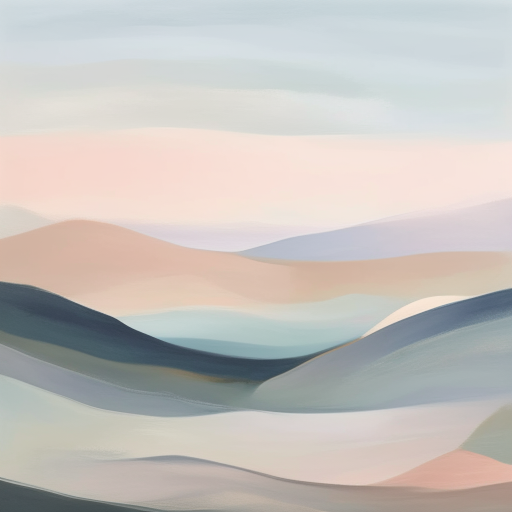

Token indices sequence length is longer than the specified maximum sequence length for this model (80 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['abstract space .']


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

'A minimal composition of dynamic geometric shapes in soft, muted tones. Rounded rectangles, circles, and angular forms interact with subtle overlap and spacing, arranged in a balanced layout on a neutral background. The scene is rendered in flat design with no gradients or shadows, using a front-facing or isometric perspective to suggest motion and tension within a calm, abstract space.'

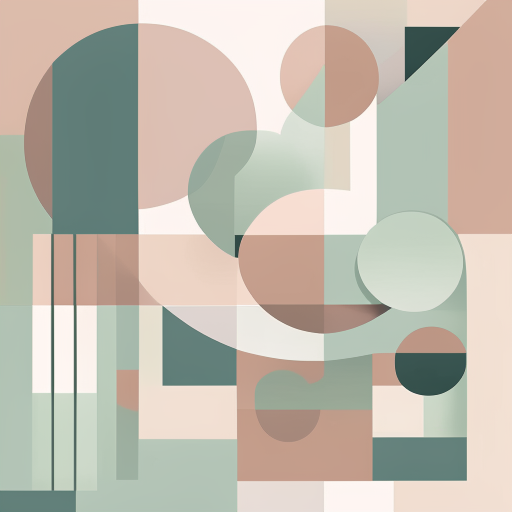

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ful development within a clean , modern space .']


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

'An abstract minimalistic composition symbolizing growth and progress through gently ascending geometric forms with rounded corners. Shapes are arranged in a balanced, harmonious layout using a calm corporate color palette of muted blues and soft grays. The design employs flat colors without gradients or shadows, presented in a front-facing or subtle isometric perspective, conveying steady upward movement and purposeful development within a clean, modern space.'

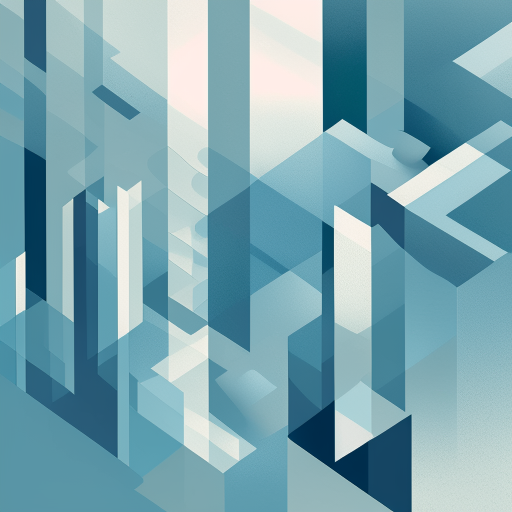

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['.']


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

'A minimalistic 2D abstract illustration of a futuristic workspace featuring clean, precise lines and simplified, stylized human figures. The composition uses a harmonious palette of soft pastel colors limited to four tones, with flat shapes and subtle outlines. The layout is balanced and geometric, emphasizing clarity and calmness, avoiding photographic or 3D effects, and maintaining a modern, corporate aesthetic.'

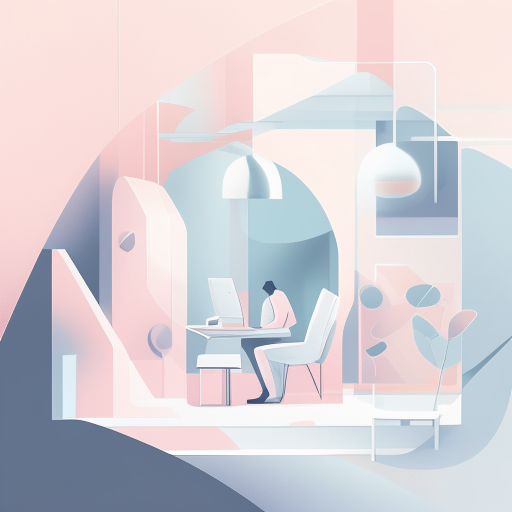

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

'A minimalistic flat 2D illustration of a futuristic abstract cityscape with rounded corners and soft edges. The design features clean geometric shapes arranged in an isometric perspective, using a limited palette of three harmonious pastel colors. The composition is balanced and smooth, with no sharp contrasts or photographic elements, emphasizing simplicity and brand-consistent clarity.'

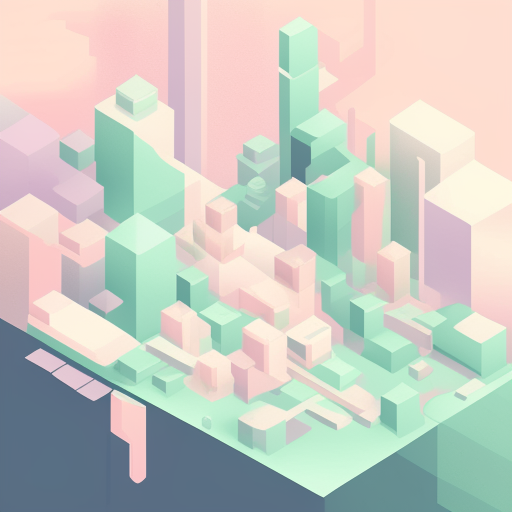

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

'A minimalistic flat 2D illustration of a human figure abstractly connected with technology through soft, light-colored geometric shapes. The design features smooth rounded corners and balanced composition in an isometric style, using a limited palette of three harmonious pastel tones. The image emphasizes clarity and simplicity with subtle contrasts and clean lines, avoiding photographic or 3D effects.'

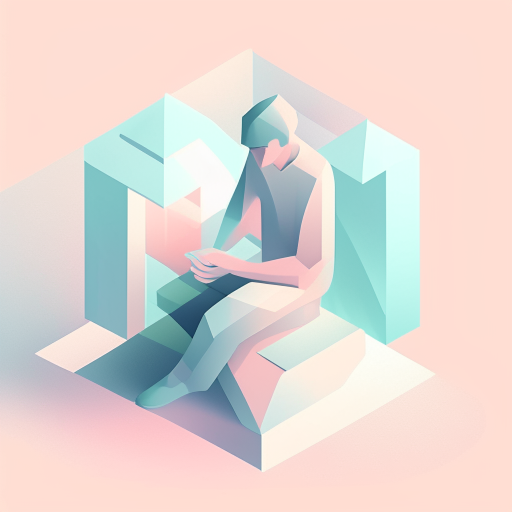

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

'A minimalistic flat 2D line art illustration symbolizing collaboration, composed of interconnected abstract shapes with smooth rounded corners. The design uses a restrained palette of three soft, harmonious colors with subtle contrasts. The composition is clean and balanced, rendered in an isometric or front-facing style, emphasizing clarity and simplicity without photographic or 3D elements.'

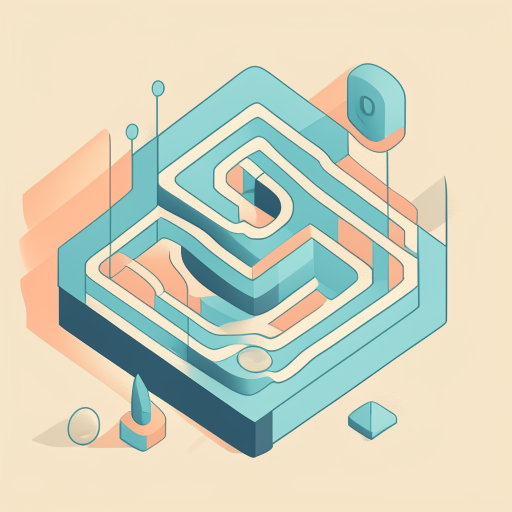

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

'A minimalistic flat 2D abstract illustration representing clarity and focus, featuring smooth, rounded shapes arranged in a balanced composition. The design employs a limited palette of soft, muted colors with gentle contrasts, rendered in an isometric or front-facing style. The image is clean, structured, and adheres to flat design principles without any photographic or 3D effects.'

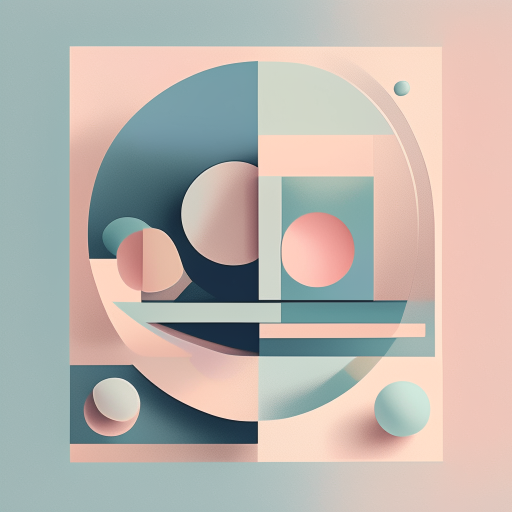

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

'A minimalistic flat 2D abstract illustration of a futuristic cityscape composed of smooth, rounded geometric shapes symbolizing energy and movement. The composition features balanced isometric or front-facing perspectives, using a limited palette of soft, muted colors with gentle contrasts. The design emphasizes clean lines, simplicity, and flat design principles without photographic or 3D effects.'

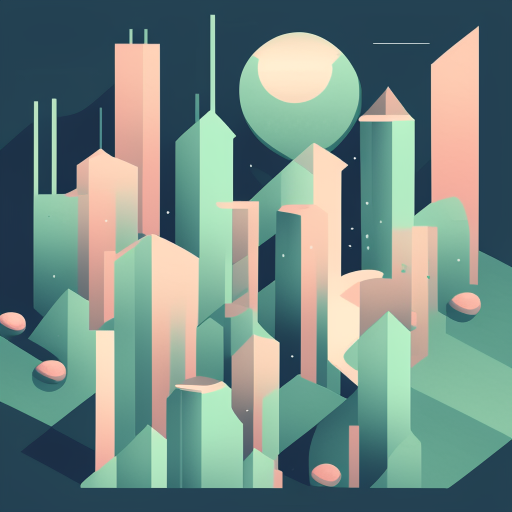

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

'A minimalistic flat 2D illustration of a futuristic abstract city composed of smooth, rounded geometric shapes with soft, muted colors and gentle contrasts. The design features balanced isometric or front-facing perspectives, clean lines, and a harmonious composition emphasizing simplicity and softness without photographic or 3D elements.'

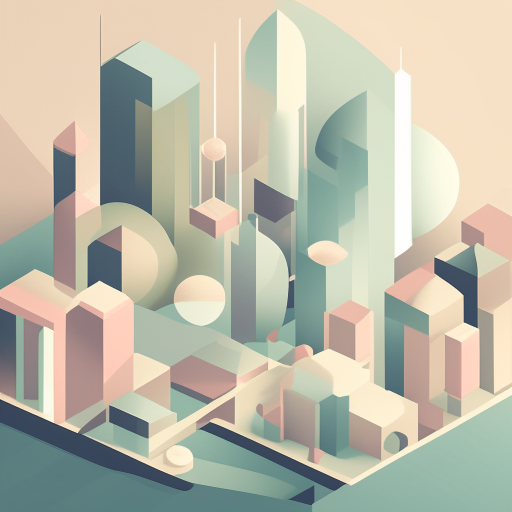

In [18]:
from IPython.display import display


for idx, prompt in enumerate(gpt_improved_prompts):
    image = generate_image_with_diffusers(kandinsky_pipe, prompt, steps=100)
    image.save(f"kandinsky-2-2-decoder_improved_{idx}_generated.png")
    display(prompt, image)

#### Подсчет `BLIP` score для изображений с улучшенным `RAG` промптом.

In [50]:
# Загрузка сгенерированных изображений
from pathlib import Path


improved_kandinsky_img_paths = sorted(list(Path("/kaggle/input/output/output/kandinsky-2-2-decoder/improved").iterdir()))

In [51]:
improved_kandinsky_blip_scores = []

for img_path, prompt in zip(improved_kandinsky_img_paths, gpt_improved_prompts):
    score = blip_similarity(img_path, prompt)
    improved_kandinsky_blip_scores.append(score)

In [52]:
improved_kandinsky_blip_scores

[0.9912068247795105,
 0.9928754568099976,
 0.9811940789222717,
 0.9875935912132263,
 0.9998283386230469,
 0.9997262358665466,
 0.9760105609893799,
 0.906467616558075,
 0.9994906187057495,
 0.9999263286590576]

#### Генерация изображений c промптами без `RAG` для модели `kandinsky-2-2-decoder`

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

'Generate a calm abstract landscape in soft pastel tones'

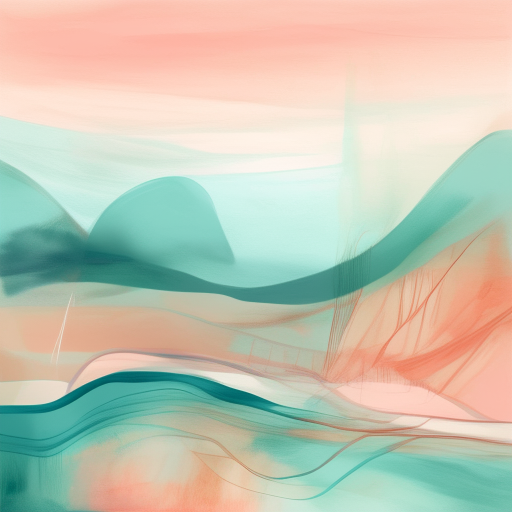

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

'Show dynamic geometric shapes interacting in a minimal composition'

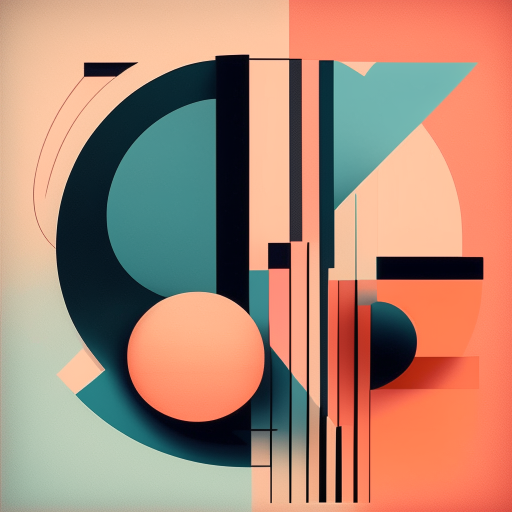

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

'Create a visual metaphor for growth and progress using minimal abstract forms and a calm corporate palette.'

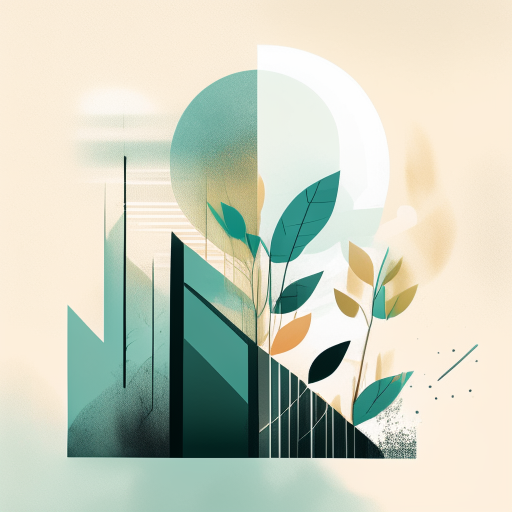

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

'Illustrate a futuristic workspace concept with clean lines, abstract people, and harmonious light colors.'

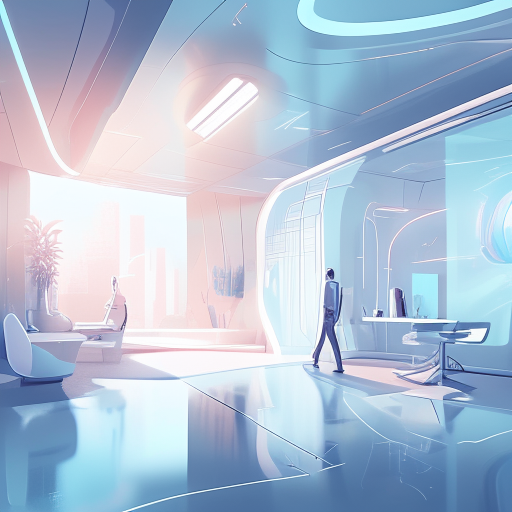

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

'Create a futuristic abstract city in flat 2D style'

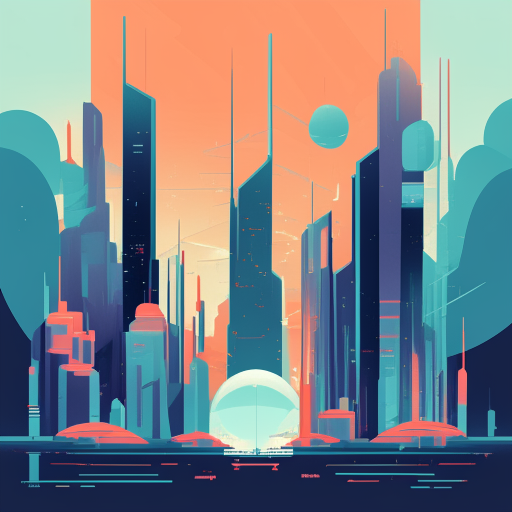

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

'Visualize a human figure connecting with technology through light-colored geometric abstraction.'

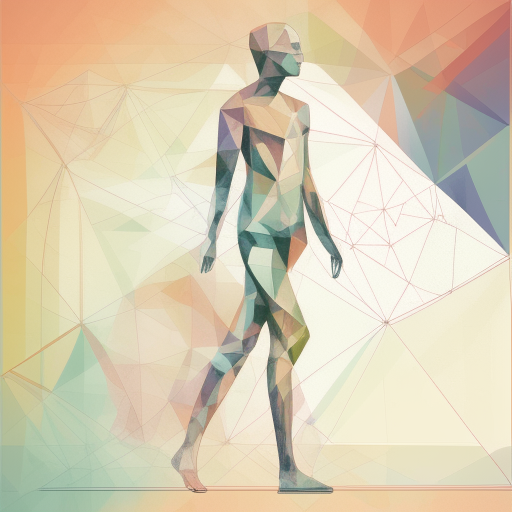

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

'Design a conceptual image of collaboration using line art'

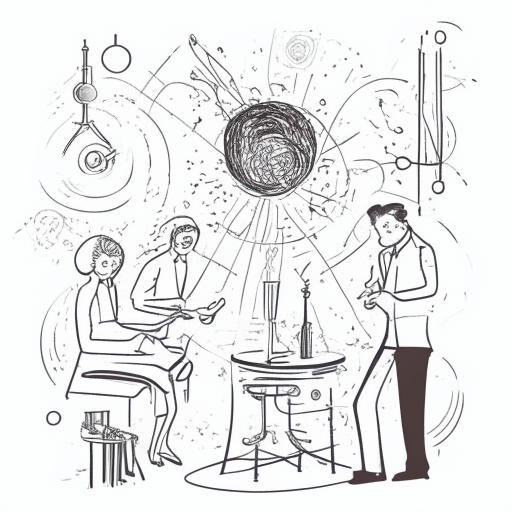

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

'Create a visual metaphor for clarity and focus, minimal style'

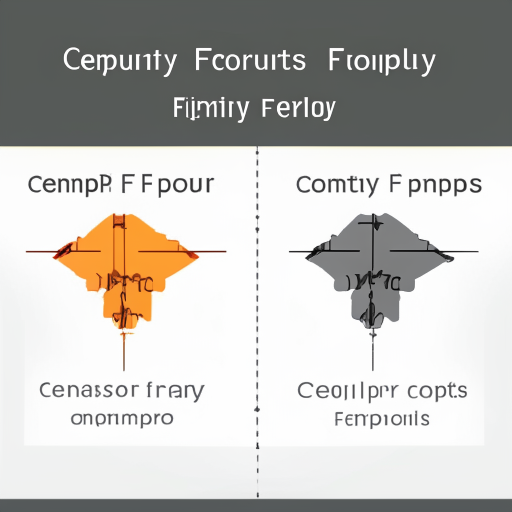

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

'Depict energy and movement using simple shapes and flat design'

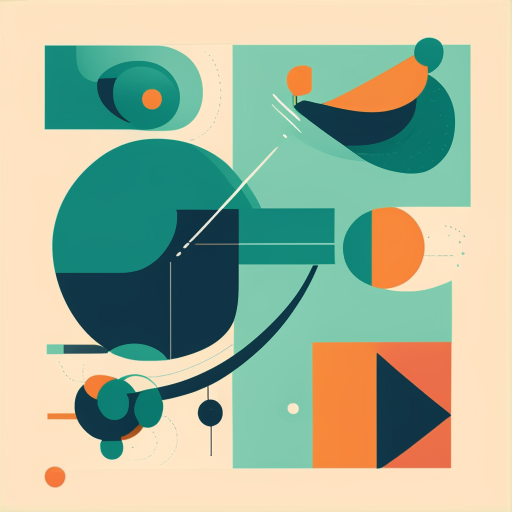

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

'Create a futuristic abstract city in flat 2D style'

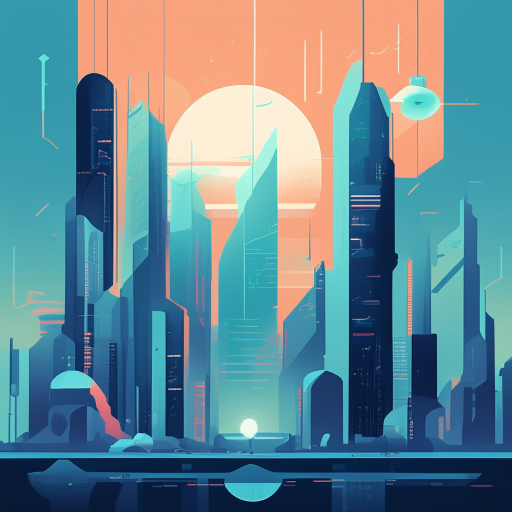

In [6]:
from IPython.display import display


for idx, prompt in enumerate(raw_user_prompts):
    image = generate_image_with_diffusers(kandinsky_pipe, prompt, steps=100)
    image.save(f"kandinsky-2-2-decoder_raw_{idx}_generated.png")
    display(prompt, image)

In [53]:
# Загрузка сгенерированных изображений
from pathlib import Path


raw_kandinsky_img_paths = sorted(list(Path("/kaggle/input/output/output/kandinsky-2-2-decoder/raw").iterdir()))

In [54]:
kandinsky_blip_scores = []

for img_path, prompt in zip(raw_kandinsky_img_paths, raw_user_prompts):
    score = blip_similarity(img_path, prompt)
    kandinsky_blip_scores.append(score)

In [55]:
kandinsky_blip_scores

[0.998494029045105,
 0.9620848298072815,
 0.9977582097053528,
 0.9992658495903015,
 0.9995744824409485,
 0.9997996687889099,
 0.9783387184143066,
 0.003712215693667531,
 0.983920156955719,
 0.9996867179870605]

#### Подсчет средних значений `BLIP` scores

In [60]:
mean_raw_kandinsky = sum(kandinsky_blip_scores) / len(kandinsky_blip_scores)
mean_improved_kandinsky = sum(improved_kandinsky_blip_scores) / len(improved_kandinsky_blip_scores)

print(f"Mean user prompt scores: {round(mean_raw_kandinsky, 3)}\nMean improved prompt scores: {round(mean_improved_kandinsky, 3)}")

Mean user prompt scores: 0.892
Mean improved prompt scores: 0.983


In [95]:
import matplotlib.pyplot as plt


def plot_blip_comparison(models, raw_scores, improved_scores, y, title='Comparison of Raw vs Improved Prompts'):
    """
    Строит график сравнения средних оценок для сырых и улучшенных промптов.
    """
    x = range(len(models))
    bar_width = 0.35
    plt.figure(figsize=(10, 6))

    raw_bars = plt.bar([i - bar_width / 2 for i in x], raw_scores, width=bar_width, label='Raw prompt', color='skyblue')
    improved_bars = plt.bar([i + bar_width / 2 for i in x], improved_scores, width=bar_width, label='Improved prompt (RAG)', color='lightgreen')

    for bar in raw_bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2.0, height + 0.01, f'{height:.3f}', ha='center', va='bottom', fontsize=9)

    for bar in improved_bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2.0, height + 0.01, f'{height:.3f}', ha='center', va='bottom', fontsize=9)
    
    plt.xlabel('Model')
    plt.ylabel(y)
    plt.title(title)
    plt.xticks(x, models, rotation=15)
    plt.ylim(0, 1)
    plt.legend()
    plt.grid(axis='y', linestyle='--', alpha=0.7)

    plt.tight_layout()
    plt.show()


#### Визуализация полученных средних `BLIP` scores

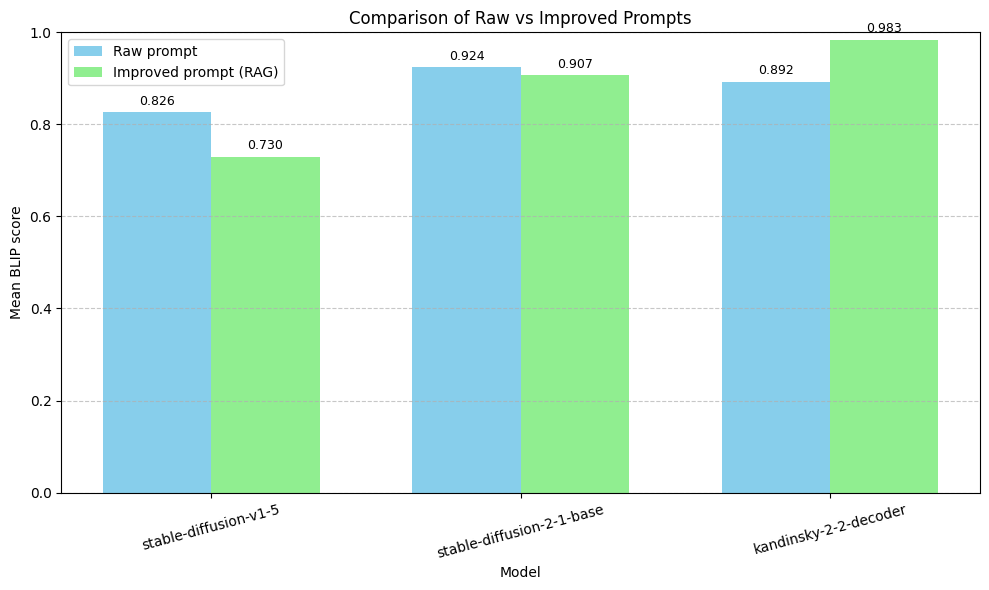

In [96]:
models = ('stable-diffusion-v1-5', 'stable-diffusion-2-1-base', 'kandinsky-2-2-decoder')
raw_scores = (mean_raw_diffusion_1_5, mean_raw_diffusion_2_1, mean_raw_kandinsky)
improved_scores =(mean_improved_diffusion_1_5, mean_improved_diffusion_2_1, mean_improved_kandinsky)

plot_blip_comparison(models=models, raw_scores=raw_scores, improved_scores=improved_scores, y="Mean BLIP score")

#### Вывод
Исходя из полученных данных видно:
- для модели `stable-diffusion-v1-5` при использование `RAG` метрика `BLIP` хуже
- для модели `stable-diffusion-2-1-base` с использованием `RAG` метрика `BLIP` чуть лучше, но примерно на одном уровне без использования
- для модели `kandinsky-2-2-decoder` с улучшенным промптом метрика показала лучший результат

#### 4.2 LPIPS: Сходство со стилевыми паттернами

LPIPS (Learned Perceptual Image Patch Similarity) — это метрика, специально разработанная для оценки перцептуального сходства изображений. В отличие от традиционных метрик, таких как PSNR или SSIM, LPIPS ориентирована на сходство восприятия человеком, а не на числовое совпадение пикселей. LPIPS оценивает схожесть не на уровне простых пиксельных разностей, а с учётом перцептуальных особенностей изображений, таких как формы, текстуры и другие стилистические особенности.

#### Интерпретация метрики LPIPS

| LPIPS Score   | Интерпретация         |
|---------------|------------------------|
| 0.01 – 0.05   | Почти идентичны        |
| 0.05 – 0.15   | Очень похожи           |
| 0.15 – 0.30   | Умеренно различны      |
| 0.30 – 0.50   | Заметно различны       |
| > 0.50        | Сильно отличаются      |


In [62]:
!pip install lpips

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.8/53.8 kB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.6 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.1 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 3.1 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 4.5 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.2 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.0 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 81.1 MB/s eta 0:00:00:00:0100:01
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.8.93
    Uninstalling nvidia-nvjitlink-cu12-12.8.93:
      Successfully uninstalled nvidia-nvjitlink-cu12-12.8.93
  Attempting uninstall: nvidia-curand-cu12
    Found existing in

In [63]:
# Загружаем модель на устройство

import lpips
import torch
from torchvision import transforms


device = "cuda" if torch.cuda.is_available() else "cpu"

loss_fn = lpips.LPIPS(net='vgg').to(device)
preprocess = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),  # Нормализация для LPIPS
])

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:02<00:00, 203MB/s] 


Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/vgg.pth


/usr/local/lib/python3.11/dist-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(model_path, map_location='cpu'), st

In [64]:
def preprocess_image(image_path: str, preprocess):
    image = Image.open(image_path).convert('RGB')
    return preprocess(image).unsqueeze(0).to(device)

In [69]:
from tqdm import tqdm


def compute_average_lpips(generated_image_paths, original_image_paths):
    scores = []

    for gen_path in tqdm(generated_image_paths, desc="Computing LPIPS"):
        gen_img = preprocess_image(gen_path, preprocess)

        for orig_path in original_image_paths:
            orig_img = preprocess_image(orig_path, preprocess)

            with torch.no_grad():
                lpips_score = loss_fn(gen_img, orig_img).item()
            
            scores.append(lpips_score)

    return sum(scores) / len(scores)

In [67]:
"""Загрузка оригинального корпоративного контента"""
from pathlib import Path


original_image_paths = list(path for path in Path("/kaggle/input/images/imgs/compositions").iterdir() if str(path).split(".")[-1] != "txt")

In [70]:
"""Подсчет среднего `LPIPS` для результатов модели `stable-diffusion-v1-5` с сырым промптом без `RAG`."""

raw_diffusion_1_5_avg_lpips = compute_average_lpips(raw_diffusion_1_5_img_paths, original_image_paths)

Computing LPIPS: 100%|██████████| 10/10 [00:15<00:00,  1.60s/it]


In [72]:
"""Подсчет среднего `LPIPS` для результатов модели `stable-diffusion-v1-5` с улучшенным промптом с `RAG`."""

improved_diffusion_1_5_avg_lpips = compute_average_lpips(improved_diffusion_1_5_img_paths, original_image_paths)

Computing LPIPS: 100%|██████████| 10/10 [00:15<00:00,  1.59s/it]


In [79]:
"""Подсчет среднего `LPIPS` для результатов модели `stable-diffusion-2-1-base` с сырым промптом без `RAG`."""

raw_diffusion_2_1_avg_lpips = compute_average_lpips(raw_diffusion_2_1_img_paths, original_image_paths)

Computing LPIPS: 100%|██████████| 10/10 [00:15<00:00,  1.57s/it]


In [78]:
"""Подсчет среднего `LPIPS` для результатов модели `stable-diffusion-v1-5` с улучшенным промптом с `RAG`."""

improved_diffusion_2_1_avg_lpips = compute_average_lpips(improved_diffusion_2_1_img_paths, original_image_paths)

Computing LPIPS: 100%|██████████| 10/10 [00:15<00:00,  1.56s/it]


In [80]:
"""Подсчет среднего `LPIPS` для результатов модели `kandinsky-2-2-decoder` с сырым промптом без `RAG`."""

raw_kandinsky_avg_lpips = compute_average_lpips(raw_kandinsky_img_paths, original_image_paths)

Computing LPIPS: 100%|██████████| 10/10 [00:15<00:00,  1.57s/it]


In [81]:
"""Подсчет среднего `LPIPS` для результатов модели `kandinsky-2-2-decoder` с улучшенным промптом с `RAG`."""

improved_kandinsky_avg_lpips = compute_average_lpips(improved_kandinsky_img_paths, original_image_paths)

Computing LPIPS: 100%|██████████| 10/10 [00:15<00:00,  1.57s/it]


#### Визуализация полученных средних `LPIPS` scores

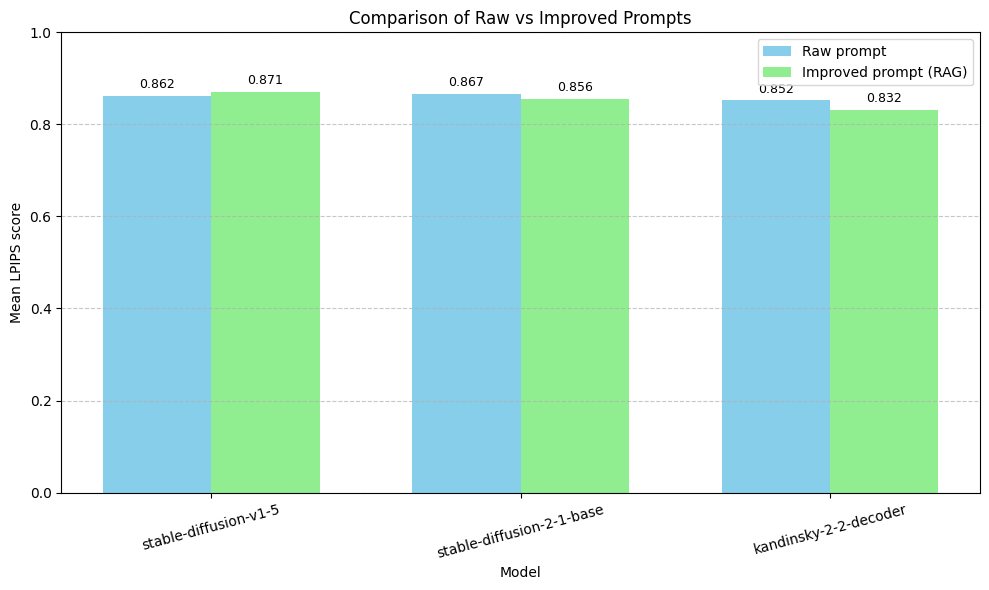

In [98]:
raw_lpips_scores = (raw_diffusion_1_5_avg_lpips, raw_diffusion_2_1_avg_lpips, raw_kandinsky_avg_lpips)
improved_lpips_scores =(improved_diffusion_1_5_avg_lpips, improved_diffusion_2_1_avg_lpips, improved_kandinsky_avg_lpips)

plot_blip_comparison(models=models, raw_scores=raw_lpips_scores, improved_scores=improved_lpips_scores, y="Mean LPIPS score")

#### Вывод
Из полученных результатов видно, что лучшая `LPIPS` метрика достигается у модели `kandinsky-2-2-decoder` с улучшенным промптом.

#### 4.3 Совмещаем метрики в одну общую
Возьмем веса метрик следующим образом `alpha = 0.7` (вес `LPIPS`, выше, так как для нас важнее). `beta = 0.3` (вес `BLIP`).

In [125]:
import pandas as pd
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler


data = [
    {"model": "stable-diffusion-v1-5", "prompt_type": "raw",       "lpips": raw_diffusion_1_5_avg_lpips, "blip": mean_raw_diffusion_1_5},
    {"model": "stable-diffusion-v1-5", "prompt_type": "improved",  "lpips": improved_diffusion_1_5_avg_lpips, "blip": mean_improved_diffusion_1_5},

    {"model": "stable-diffusion-2-1-base", "prompt_type": "raw",       "lpips": raw_diffusion_2_1_avg_lpips, "blip": mean_raw_diffusion_2_1},
    {"model": "stable-diffusion-2-1-base", "prompt_type": "improved",  "lpips": improved_diffusion_2_1_avg_lpips, "blip": mean_improved_diffusion_2_1},

    {"model": "kandinsky-2-2-decoder", "prompt_type": "raw",      "lpips": raw_kandinsky_avg_lpips, "blip": mean_raw_kandinsky},
    {"model": "kandinsky-2-2-decoder", "prompt_type": "improved", "lpips": improved_kandinsky_avg_lpips, "blip": mean_improved_kandinsky},
]

df = pd.DataFrame(data)

In [135]:
# 1. Нормализуем LPIPS (меньше — лучше)
scaler = MinMaxScaler()
df["lpips_norm"] = 1 - scaler.fit_transform(df[["lpips"]])  # инверсия: больше — лучше

alpha = 0.7  # вес LPIPS
beta = 0.3   # вес BLIP

df["final_score"] = alpha * df["lpips_norm"] + beta * df["blip"]
df["model_prompt"] = df["model"] + "\n(" + df["prompt_type"] + ")"

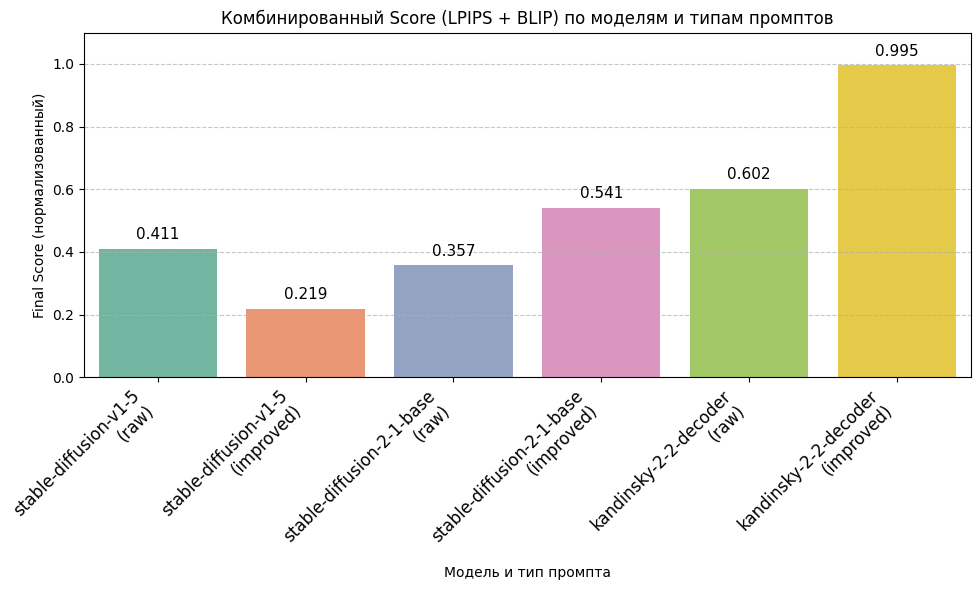

In [140]:
plt.figure(figsize=(10, 6))
ax = sns.barplot(data=df, x="model_prompt", y="final_score", order=df["model_prompt"], palette="Set2")

plt.title("Комбинированный Score (LPIPS + BLIP) по моделям и типам промптов")
plt.ylabel("Final Score (нормализованный)")
plt.xlabel("Модель и тип промпта")
plt.ylim(0, 1.1)
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.xticks(rotation=45, ha="right", fontsize=12)
plt.tight_layout()

for p in ax.patches:
    height = p.get_height()
    ax.text(
        p.get_x() + p.get_width() / 2,
        height + 0.02,
        f"{height:.3f}",
        ha="center",
        va="bottom",
        fontsize=11,
        color="black"
    )

plt.show()

## Вывод
Исходя из значений совмещенной метрики, выбор модели для генерации корпоративного контента будет следующим:

Выбираем модель `kandinsky-2-2-decoder` с `RAG` пайплайном, так как она имеет наивысший комбинированный балл `0.995`. Это означает, что эта модель показывает лучшее качество по обеим метрикам `(BLIP и LPIPS)` среди всех рассматриваемых моделей.